In [2]:
import sys
import os

import pandas as pd
import scanpy as sc
import numpy as np
import warnings

import torch
import torch.nn.functional as F
import torch.nn as nn

from torch.utils.data import DataLoader, TensorDataset
from torch.nn import DataParallel
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
import anndata
import seaborn as sns
import matplotlib.font_manager
from matplotlib import rcParams

font_list = []
fpaths = matplotlib.font_manager.findSystemFonts()
for i in fpaths:
    try:
        f = matplotlib.font_manager.get_font(i)
        font_list.append(f.family_name)
    except RuntimeError:
        pass

font_list = set(font_list)
plot_font = 'Helvetica' if 'Helvetica' in font_list else 'FreeSans'
rcParams['font.family'] = plot_font
rcParams.update({'font.size': 10})
rcParams.update({'figure.dpi': 300})
rcParams.update({'figure.figsize': (3,3)})
rcParams.update({'savefig.dpi': 500})
warnings.filterwarnings('ignore')

%load_ext autoreload
%autoreload 2
import os
os.environ["CUDA_LAUNCH_BLOCKING"] = "1"

# prepare data

In [ ]:
count = pd.read_csv('/hpc/mydata/siyu.he/Siyu_projects/squidward_study/raw_datasets/simulate/toy_sc_RNA_count.csv', index_col=0).transpose()
meta = pd.read_csv('/hpc/mydata/siyu.he/Siyu_projects/squidward_study/raw_datasets/simulate/toy_sc_RNA_meta.csv', index_col=0)
adata = anndata.AnnData(count)
adata.obs=meta.copy()
adata.layers["counts"] = adata.X.copy()

In [ ]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

# Identify the most highly variable genes
sc.pp.highly_variable_genes(adata, n_top_genes=100)

# Filter the dataset to keep only these genes
adata = adata[:, adata.var.highly_variable]

In [ ]:
encoded_obs = adata.obs.copy()

for column in encoded_obs.columns:
    if encoded_obs[column].dtype == 'object':
        encoded_obs[column] = pd.factorize(adata.obs[column])[0]
adata.obs  = encoded_obs

In [ ]:
adata

In [6]:
adata.write('/hpc/mydata/siyu.he/Siyu_projects/squidward_study/data_for_run/adata_simulate.h5ad')

# load data

In [3]:
adata = sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/squidward_study/data_for_run/adata_simulate.h5ad')

# run scVI

# load scVI results

# run squidiff

In [3]:
#import subprocess
#subprocess.run(["/bin/bash", "./run_simulate.sh"])

In [4]:
font_list = []
fpaths = matplotlib.font_manager.findSystemFonts()
for i in fpaths:
    try:
        f = matplotlib.font_manager.get_font(i)
        font_list.append(f.family_name)
    except RuntimeError:
        pass

font_list = set(font_list)
plot_font = 'Helvetica' if 'Helvetica' in font_list else 'FreeSans'
rcParams['font.family'] = plot_font
rcParams.update({'font.size': 10})
rcParams.update({'figure.dpi': 300})
rcParams.update({'figure.figsize': (3,3)})
rcParams.update({'savefig.dpi': 500})
warnings.filterwarnings('ignore')

%load_ext autoreload
%autoreload 2

import io
import os
import socket

import torch as th
import torch.distributed as dist
import argparse

from Squidiff import dist_util,logger

from Squidiff.scrna_datasets import load_simulate_data,prepared_data
from Squidiff.resample import create_named_schedule_sampler
from Squidiff.script_util import (
    model_and_diffusion_defaults,
    create_model_and_diffusion,
    args_to_dict,
    add_dict_to_argparser,
)

from Squidiff.train_util import TrainLoop

GPUS_PER_NODE = 1  # Set this to the actual number of GPUs per node



The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [5]:
!nvidia-smi

Fri Nov  8 10:59:40 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 560.35.03              Driver Version: 560.35.03      CUDA Version: 12.6     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A100-SXM4-40GB          On  |   00000000:41:00.0 Off |                    0 |
| N/A   27C    P0             51W /  400W |       1MiB /  40960MiB |      0%      Default |
|                                         |                        |             Disabled |
+-----------------------------------------+-----

In [6]:

def get_default_args():
    defaults = dict(
        data_dir="",
        schedule_sampler="uniform",
        lr=1e-4,
        weight_decay=0.0,
        lr_anneal_steps=0,
        batch_size=64,
        microbatch=-1,  # -1 disables microbatches
        ema_rate="0.9999",  # comma-separated list of EMA values
        log_interval=5000,
        save_interval=10000,
        resume_checkpoint="",
        use_fp16=False,
        fp16_scale_growth=1e-3,
        use_encoder=False,
        diffusion_steps=1000,
    )
    defaults.update(model_and_diffusion_defaults())
    return defaults



def setup_dist():
    """
    Setup a distributed process group.
    """
    if dist.is_initialized():
        return
    backend = "gloo" if not th.cuda.is_available() else "nccl"
    dist.init_process_group(backend=backend, init_method="env://")


def dev():
    """
    Get the device to use for torch.distributed.
    """
    if th.cuda.is_available():
        return th.device(f"cuda")
    return th.device("cpu")


def load_state_dict(path, **kwargs):
    """
    Load a PyTorch file without redundant fetches across ranks.
    """
    chunk_size = 2 ** 30  # Size limit for data chunks
    if dist.get_rank() == 0:
        with open(path, "rb") as f:
            data = f.read()
        num_chunks = len(data) // chunk_size
        if len(data) % chunk_size:
            num_chunks += 1
        dist.broadcast(th.tensor(num_chunks), 0)
        for i in range(0, len(data), chunk_size):
            dist.broadcast(th.tensor(data[i: i + chunk_size]), 0)
    else:
        num_chunks = dist.broadcast(th.tensor(0), 0).item()
        data = bytes()
        for _ in range(num_chunks):
            chunk = th.zeros(chunk_size, dtype=th.uint8)
            dist.broadcast(chunk, 0)
            data += bytes(chunk.numpy())

    return th.load(io.BytesIO(data), **kwargs)


def sync_params(params):
    """
    Synchronize a sequence of Tensors across ranks from rank 0.
    """
    for p in params:
        with th.no_grad():
            dist.broadcast(p, 0)


def _find_free_port():
    """
    Find a free port for distributed training setup.
    """
    try:
        s = socket.socket(socket.AF_INET, socket.SOCK_STREAM)
        s.bind(("", 0))
        s.setsockopt(socket.SOL_SOCKET, socket.SO_REUSEADDR, 1)
        return s.getsockname()[1]
    finally:
        s.close()


def run_training(args):

    logger.configure(dir='/hpc/mydata/siyu.he/Siyu_projects/squidward_study/logger_file')

    logger.log("creating model and diffusion...")
    model, diffusion = create_model_and_diffusion(
        **args_to_dict(args, model_and_diffusion_defaults().keys())
    )
    
    model.to(dev())
    schedule_sampler = create_named_schedule_sampler(args['schedule_sampler'], diffusion)

    logger.log("creating data loader...")
    data = prepared_data(
        
        data_dir=args['data_dir'],
        fn = load_simulate_data
    )

    logger.log("training...")
    train_ = TrainLoop(
        model=model,
        diffusion=diffusion,
        data=data,
        batch_size=args['batch_size'],
        microbatch=args['microbatch'],
        lr=args['lr'],
        ema_rate=args['ema_rate'],
        log_interval=args['log_interval'],
        save_interval=args['save_interval'],
        resume_checkpoint=args['resume_checkpoint'],
        use_fp16=args['use_fp16'],
        fp16_scale_growth=args['fp16_scale_growth'],
        schedule_sampler=schedule_sampler,
        weight_decay=args['weight_decay'],
        lr_anneal_steps=args['lr_anneal_steps'],
    )
    train_.run_loop()
    return train_.loss_list


args = get_default_args()
args.update({
    'data_dir': '/hpc/mydata/siyu.he/Siyu_projects/squidward_study/data_for_run/',
    'schedule_sampler': 'uniform',
    'lr': 1e-4,
    'weight_decay': 0.0,
    'lr_anneal_steps': 1e5,
    'batch_size': 128,
    'microbatch': -1,
    'ema_rate': '0.9999',
    'log_interval': 5000,
    'save_interval': 1e4,
    'resume_checkpoint': '',
    'use_fp16': False,
    'fp16_scale_growth': 1e-3,
    'gene_size': 100, 
    'output_dim':100,
    'num_layers':3,
    'class_cond': False,  
    'use_encoder': True,
    'diffusion_steps': 1000,
})




In [ ]:
losses = run_training(args)

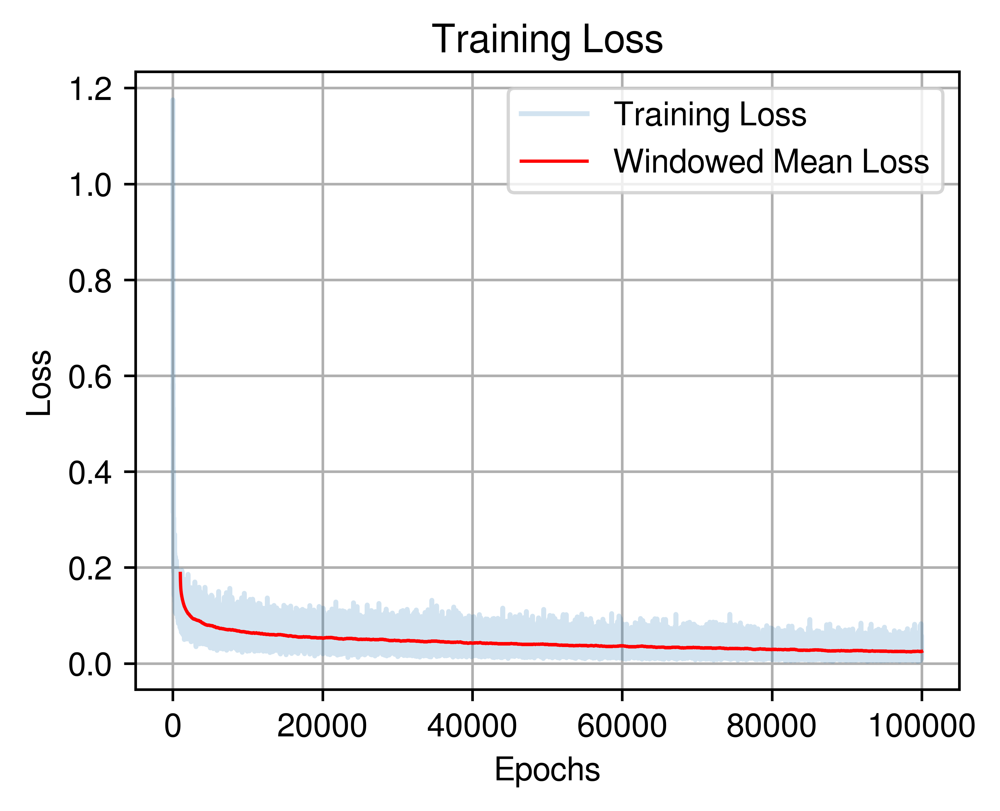

In [29]:
import matplotlib.pyplot as plt
import numpy as np

# Convert losses to a numpy array
losses_np = np.array([i.detach().cpu().numpy() for i in losses])

# Define the window size for the moving average
window_size = 1000  # You can adjust this value based on your preference

# Calculate the moving average (mean of the windowed losses)
windowed_mean_loss = np.convolve(losses_np, np.ones(window_size) / window_size, mode='valid')

# Adjust the x-axis values for the windowed mean loss
x_vals = np.linspace(0, 100000, len(losses_np))
windowed_x_vals = x_vals[window_size - 1:]  # Adjust to match the length of the windowed_mean_loss

# Plotting
plt.figure(figsize=(4.5, 3.4), dpi=800)
plt.plot(x_vals, losses_np, label='Training Loss', alpha=0.2)
plt.plot(windowed_x_vals, windowed_mean_loss, label='Windowed Mean Loss', color='r', linewidth=1)

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.legend()
plt.grid(True)
plt.show()


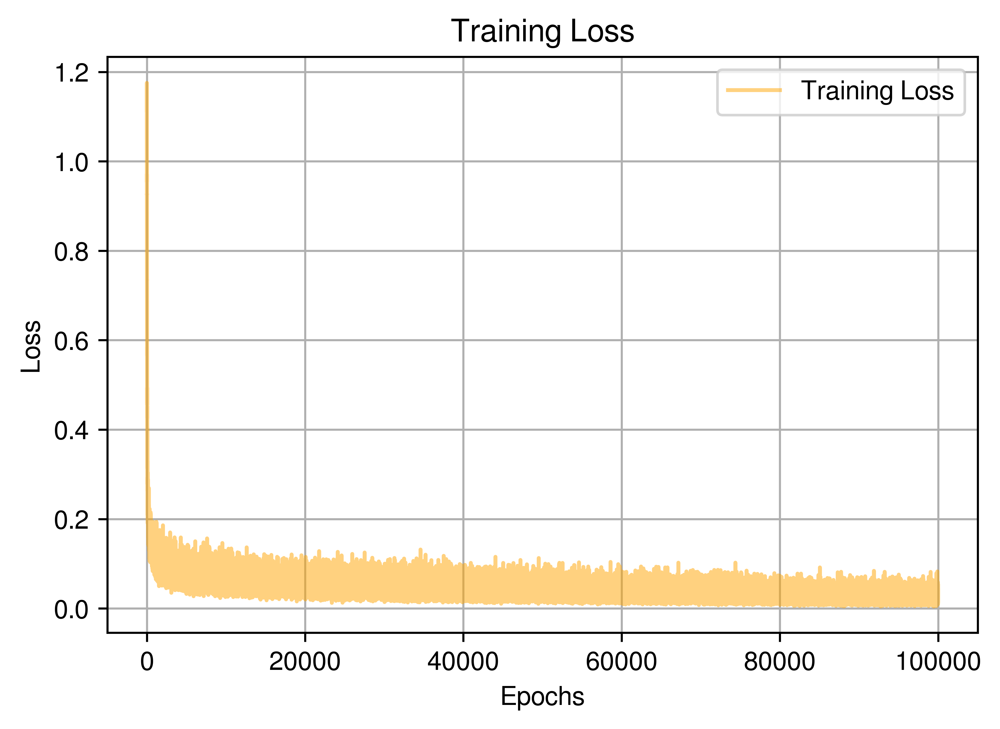

In [6]:
plt.figure(dpi=800, figsize=(6, 4))

# Plot the training loss
plt.plot([loss.detach().cpu().item() for loss in losses], label='Training Loss', color='orange',alpha=0.5)

# Add labels, title, and legend
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.legend()

# Add grid for better readability
plt.grid(True)

# Show the plot
plt.show()

In [8]:
import argparse
import os

import numpy as np
import torch as th
import torch.distributed as dist

from Squidiff import dist_util, logger
from Squidiff.script_util import (
    NUM_CLASSES,
    model_and_diffusion_defaults,
    create_model_and_diffusion,
    add_dict_to_argparser,
    args_to_dict,
)


def create_argparser():
    defaults = dict(
        clip_denoised=False,
        num_samples=2400,
        batch_size=16,
        use_ddim=False,
        diffusion_steps=500,
        model_path="saved_model/fig1_model.pt",
    )
    defaults.update(model_and_diffusion_defaults())

    return defaults


In [9]:
args = create_argparser()
args.update({
    'data_dir': '/hpc/mydata/siyu.he/Siyu_projects/squidward_study/data_for_run/',
    'schedule_sampler': 'uniform',
    'lr': 1e-4,
    'weight_decay': 0.0,
    'lr_anneal_steps': 2400,
    'batch_size': 16,
    'microbatch': -1,
    'ema_rate': '0.9999',
    'log_interval': 50,
    'save_interval': 1000,
    'resume_checkpoint': '',
    'use_fp16': False,
    'fp16_scale_growth': 1e-3,
    'gene_size': 100, 
    'output_dim':100,
    'num_layers':3,
    'class_cond': False,  
    'use_ddim':True,
    'use_encoder':True,
    'diffusion_steps': 1000,
})
#dist_util.setup_dist()

logger.configure(dir='logger_file')
logger.log("creating model and diffusion...")

model, diffusion = create_model_and_diffusion(
        **args_to_dict(args, model_and_diffusion_defaults().keys())
    )

model.load_state_dict(
    dist_util.load_state_dict(args['model_path'])
)
model.to(dist_util.dev())
if args['use_fp16']:
    model.convert_to_fp16()
model.eval()


Logging to logger_file
creating model and diffusion...
steps 1000


MLPModel(
  (encoder): EncoderMLPModel(
    (fc1): Linear(in_features=100, out_features=2048, bias=True)
    (bn1): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (fc2): Linear(in_features=2048, out_features=2048, bias=True)
    (fc3): Linear(in_features=2048, out_features=60, bias=True)
    (label_embed): Linear(in_features=1, out_features=2048, bias=True)
  )
  (time_embed): Sequential(
    (0): Linear(in_features=2048, out_features=2048, bias=True)
    (1): SiLU()
    (2): Linear(in_features=2048, out_features=2048, bias=True)
  )
  (mlp_blocks): TimestepEmbedSequential(
    (0): MLPBlock(
      (fc1): Linear(in_features=2048, out_features=2048, bias=True)
      (fc2): Linear(in_features=2048, out_features=2048, bias=True)
      (layer_norm1): LayerNorm((2048,), eps=1e-05, elementwise_affine=True)
      (layer_norm2): LayerNorm((2048,), eps=1e-05, eleme

In [10]:
data = load_simulate_data(data_dir=args['data_dir'])

In [11]:
def stochastic_encode(
    model, x, t, model_kwargs):
    """
    ddim reverse sample
    """
    sample = x
    sample_t = []
    xstart_t = []
    T = []
    indices = list(range(t))

    for i in indices:
        timestep = torch.full((x.shape[0],), i, device='cuda').long()
        with torch.no_grad():
            out = diffusion.ddim_reverse_sample(model, 
                                                sample, 
                                                timestep, 
                                                model_kwargs=model_kwargs)
            sample = out['sample']
            sample_t.append(sample)
            xstart_t.append(out['pred_xstart'])
            T.append(timestep)

    return {
    'sample': sample,
    'sample_t': sample_t,
    'xstart_t': xstart_t,
    'T': T,
}


In [12]:
from scipy.stats import gaussian_kde
def display_reconst(df_true,
                    df_pred,
                    density=False,
                    den_all = False,
                    marker_genes=None,
                    sample_rate=0.1,
                    size=(4, 4),
                    spot_size=1,
                    title=None,
                    x_label='',
                    y_label='',
                    ):
    """
    Scatter plot - raw gexp vs. reconstructed gexp
    """
    assert 0 < sample_rate <= 1, \
        "Invalid downsampling rate for reconstruct scatter plot: {}".format(sample_rate)

    if marker_genes is not None:
        marker_genes = set(marker_genes)

    df_true_sample = df_true.sample(frac=sample_rate, random_state=0)
    df_pred_sample = df_pred.loc[df_true_sample.index]

    plt.rcParams["figure.figsize"] = size
    plt.figure(dpi=800)
    ax = plt.gca()

    xx = df_true_sample.T.to_numpy().flatten()
    yy = df_pred_sample.T.to_numpy().flatten()

    if density and not den_all:
        for gene in df_true_sample.columns:
            try:
                gene_true = df_true_sample[gene].values
                gene_pred = df_pred_sample[gene].values
                gexp_stacked = np.vstack([df_true_sample[gene].values, df_pred_sample[gene].values])

                z = gaussian_kde(gexp_stacked)(gexp_stacked)
                ax.scatter(gene_true, gene_pred, c=z,vmin=0,cmap='Spectral_r',
                           s=spot_size, alpha=0.5)
            except np.linalg.LinAlgError as e:
                pass

    elif marker_genes is not None:
        color_dict = {True: 'red', False: 'green'}
        gene_colors = np.vectorize(
            lambda x: color_dict[x in marker_genes]
        )(df_true_sample.columns)
        colors = np.repeat(gene_colors, df_true_sample.shape[0])

        ax.scatter(xx, yy, c=colors, s=spot_size, alpha=0.5)

    elif density and den_all:
        gene_true = df_true_sample.values.flatten()
        gene_pred = df_pred_sample.values.flatten()
        gexp_stacked = np.vstack([df_true_sample.values.flatten(), df_pred_sample.values.flatten()])
        z = gaussian_kde(gexp_stacked)(gexp_stacked)
        ax.scatter(gene_true, gene_pred, c=z,vmin=0,cmap='Spectral_r',
                           s=spot_size, alpha=0.5)
    else:
        ax.scatter(xx, yy, s=spot_size, alpha=0.5)
    
    
        
    min_val = min(xx.min(), yy.min())
    max_val = max(xx.max(), yy.max())
    #ax.set_xlim(min_val, 400)
    
    #ax.set_ylim(min_val, 400)
    ax.set_aspect('equal',adjustable='box')
    ax.axis('equal')
    ax.set_xlim(0, max_val)
    ax.set_ylim(min_val-0.2, max_val)
    plt.suptitle(title)
    plt.xlabel(x_label)
    plt.ylabel(y_label)

    plt.show()

In [13]:
z_sem = model.encoder(torch.tensor(data[0].X).to('cuda'),
                      #label = torch.tensor(data[2].obs.values, dtype = torch.float32).to('cuda'),
                     )

model_kwargs = {'x_start':torch.tensor(data[0].X, dtype = torch.float32).to('cuda'),
                'z_mod':z_sem,
                #'cond':torch.tensor(data[2].obs.values, dtype = torch.float32).to('cuda'),
               }



In [14]:
x_T = stochastic_encode(model,
                  x = torch.tensor(data[0].X, dtype = torch.float32).to('cuda'),
                  t = 999,
                  model_kwargs=model_kwargs
                 )['sample']


In [15]:
label = data[0].obs.values[:,2]

In [23]:
import umap
def plot_embed(x_,n_neighbors=30, min_dist=0.5, n_components=2, size = 5, random_state=42):

    reducer = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, n_components=n_components, random_state=random_state)
    embedding = reducer.fit_transform(x_.detach().cpu())
    plt.figure(figsize=(3,3), dpi=800)
    colorlist = ['#ffe626', '#267dff', '#f72d65']  # Colors for cell type 123 and day 3
    plt.scatter(embedding[label==1, 0], 
                embedding[label==1, 1], 
                c=colorlist[1],
                s=size,
                alpha=1)
    
    plt.scatter(embedding[label==2, 0], 
                embedding[label==2, 1], 
                c=colorlist[2],
                s=size,
                alpha=1)
    
    plt.scatter(embedding[label==0, 0], 
                embedding[label==0, 1], 
                c=colorlist[0],
                s=size,
                alpha=1)
    plt.axis('off')
    plt.show()

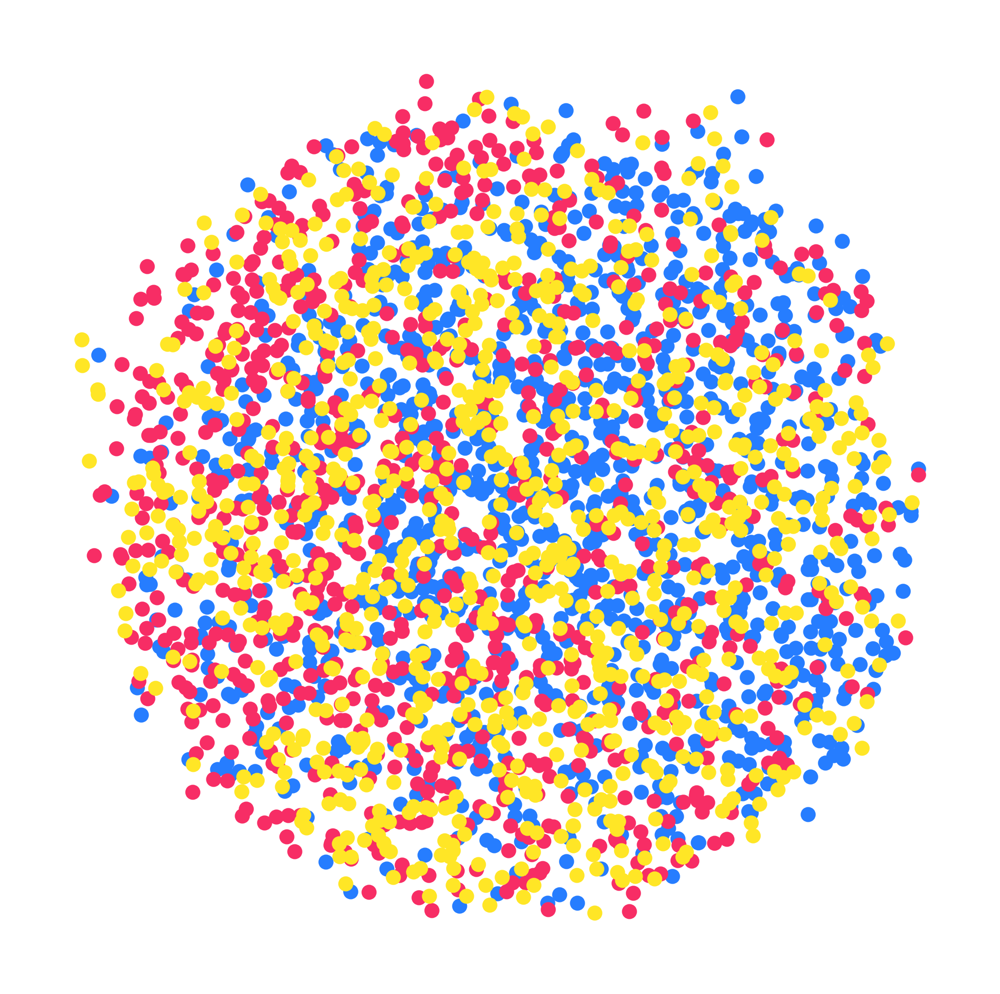

In [24]:
plot_embed(x_T,size=3)

In [14]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

def plot_embed(x_, n_components=2, size=5, random_state=42,alpha=1):
    """
    Function to plot PCA embedding of the data with color-coded labels.

    Parameters:
    - x_: Input data
    - label: Labels for coloring the embedding points
    - n_components: Number of embedding dimensions (default is 2)
    - size: Marker size in the scatter plot
    - random_state: Seed for reproducibility
    """
    
    # PCA dimensionality reduction
    pca = PCA(n_components=n_components, random_state=random_state)
    embedding = pca.fit_transform(x_.detach().cpu())
    
    # Plotting the embedding
    plt.figure(figsize=(3, 3), dpi=800)
    colorlist = ['#ffe626', '#267dff', '#f72d65']  # Colors for different cell types
    
    # Plot each label category
    plt.scatter(embedding[label == 1, 0], embedding[label == 1, 1], c=colorlist[1], s=size, alpha=alpha)
    plt.scatter(embedding[label == 2, 0], embedding[label == 2, 1], c=colorlist[2], s=size, alpha=alpha)
    plt.scatter(embedding[label == 0, 0], embedding[label == 0, 1], c=colorlist[0], s=size, alpha=alpha)
    
    plt.axis('off')
    plt.show()


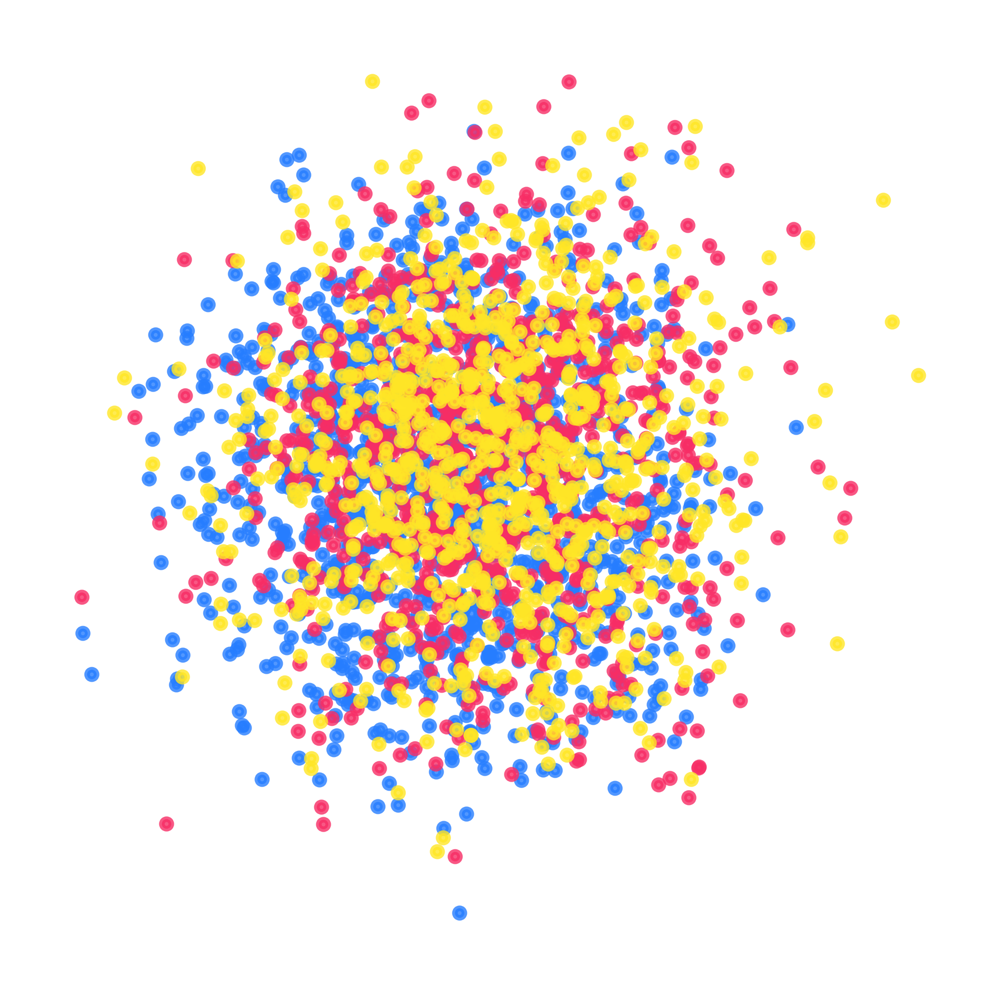

In [15]:
plot_embed(x_T,size=3,alpha=0.8)

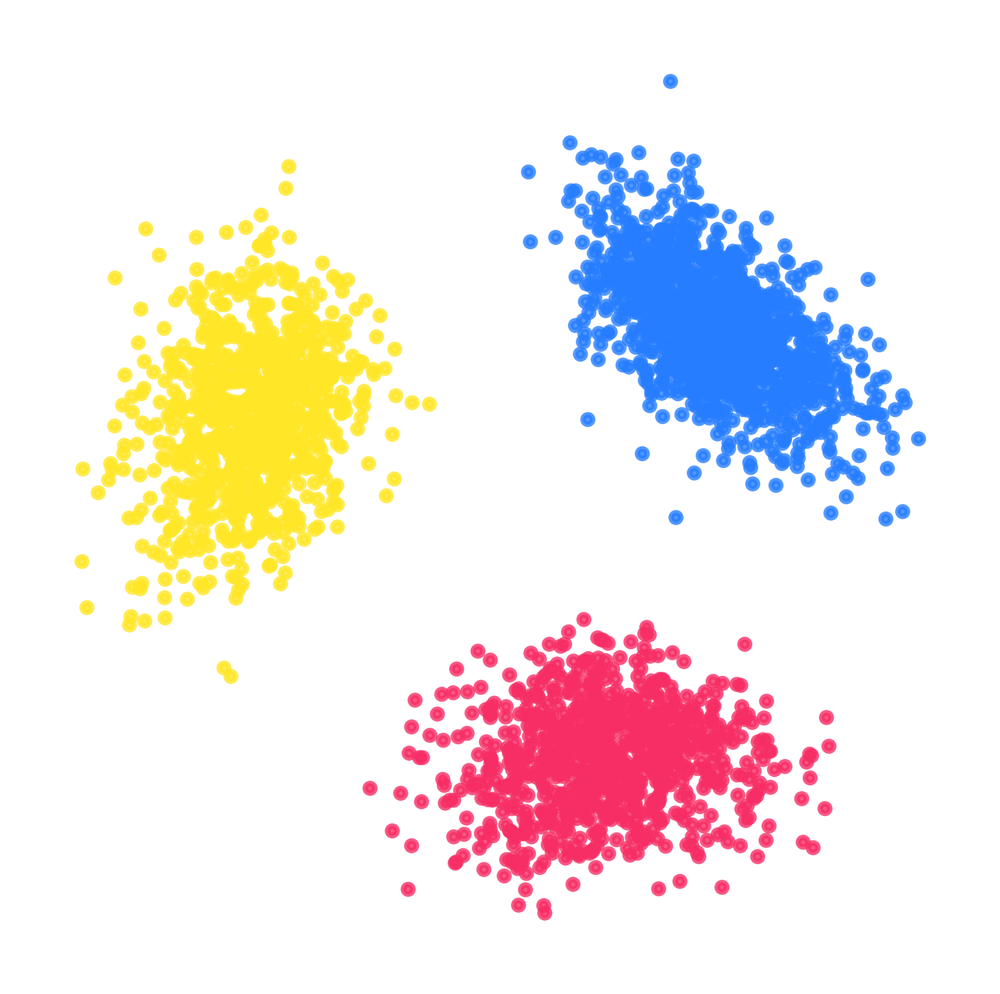

In [16]:
plot_embed(z_sem,size = 3, alpha=0.8)

In [17]:
import torch
import matplotlib.pyplot as plt

# Function to simulate diffusion steps
def get_diffused_data(model, x, t, model_kwargs):
    sample = x
    sample_t = [x]  # Store initial data for plotting
    xstart_t = []
    T = []

    indices = list(range(t))

    for i in indices:
        timestep = torch.full((x.shape[0],), i, device='cuda').long()
        with torch.no_grad():
            # Replacing ddim_reverse_sample with a simpler forward diffusion process
            noise = torch.randn_like(sample)  # Add noise at each step
            out = sample + noise * (i / t)    # Simulating diffusion based on time step
            sample = out
            sample_t.append(sample.cpu())  # Store the samples for visualization
            xstart_t.append(sample.cpu())
            T.append(timestep)

    return {
        'sample': sample,
        'sample_t': sample_t,
        'xstart_t': xstart_t,
        'T': T
    }
result = get_diffused_data(model, 
                           x = torch.tensor(data[0].X, dtype = torch.float32).to('cuda'), 
                           t=1000, 
                           model_kwargs=None)

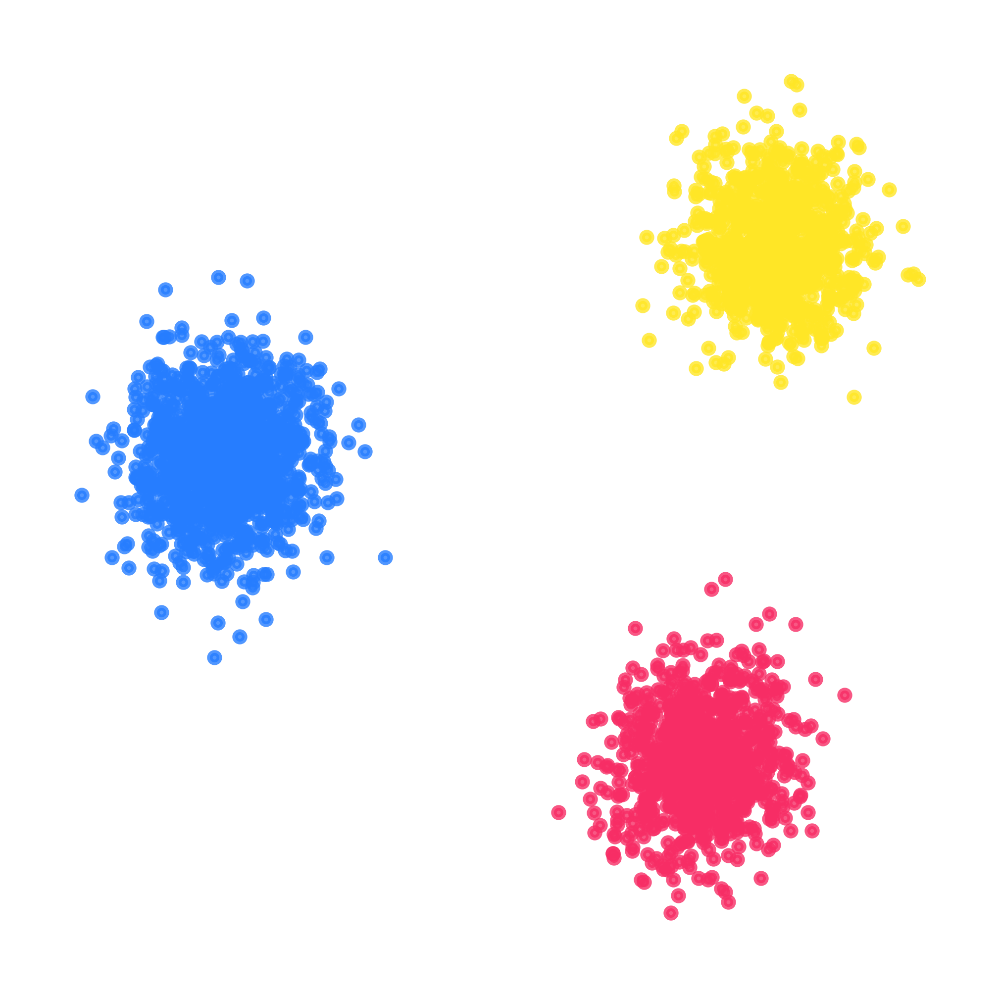

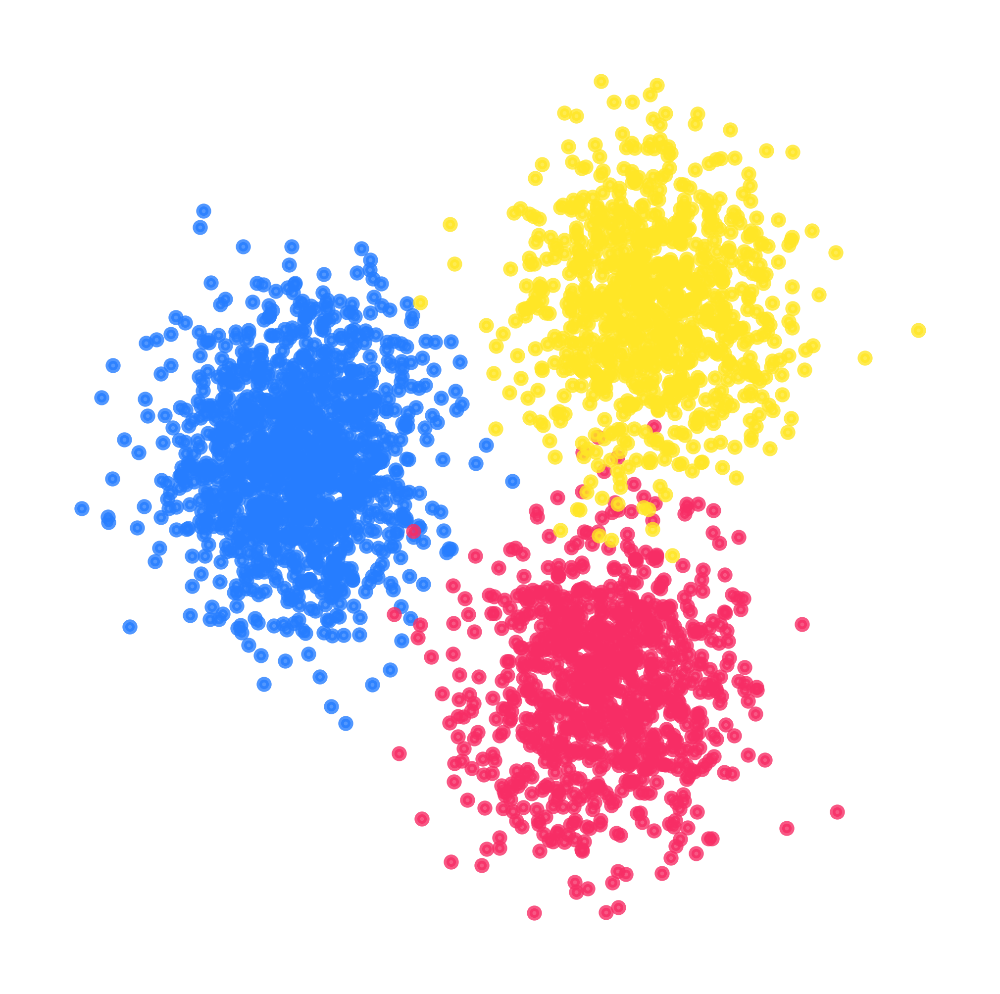

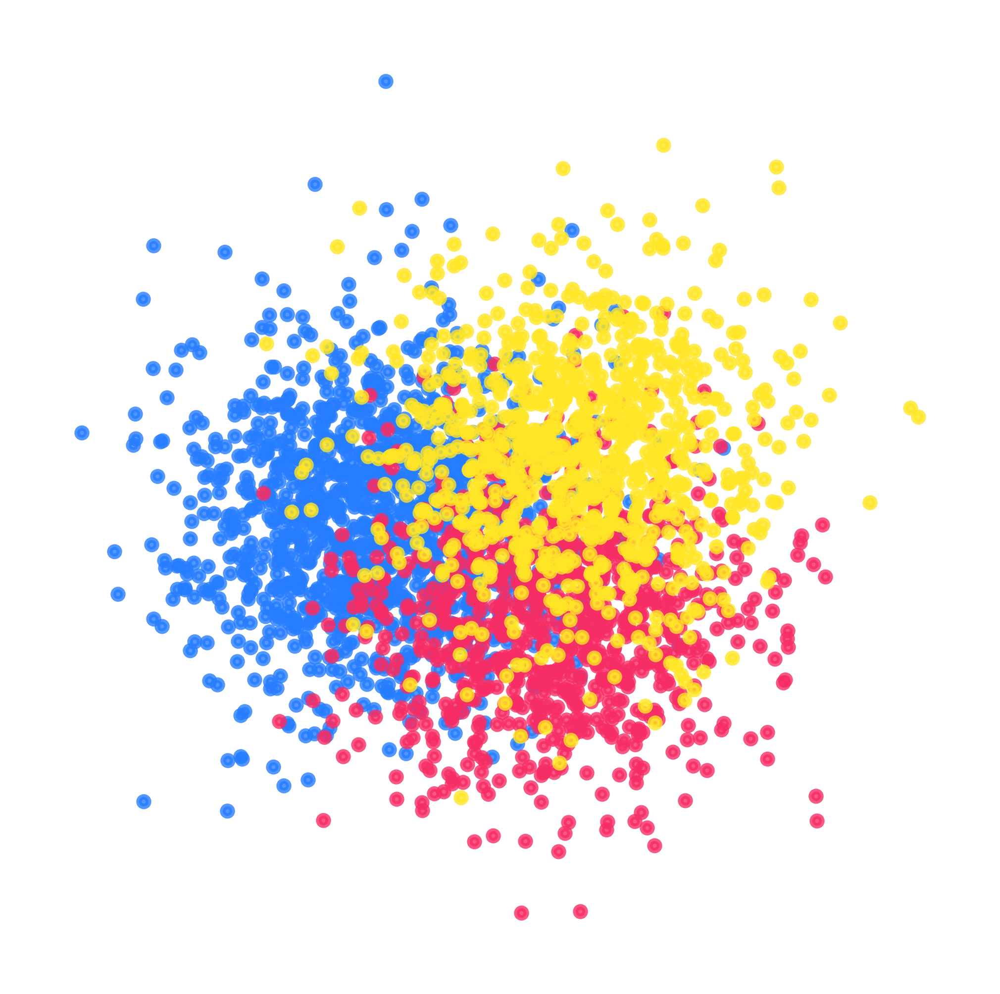

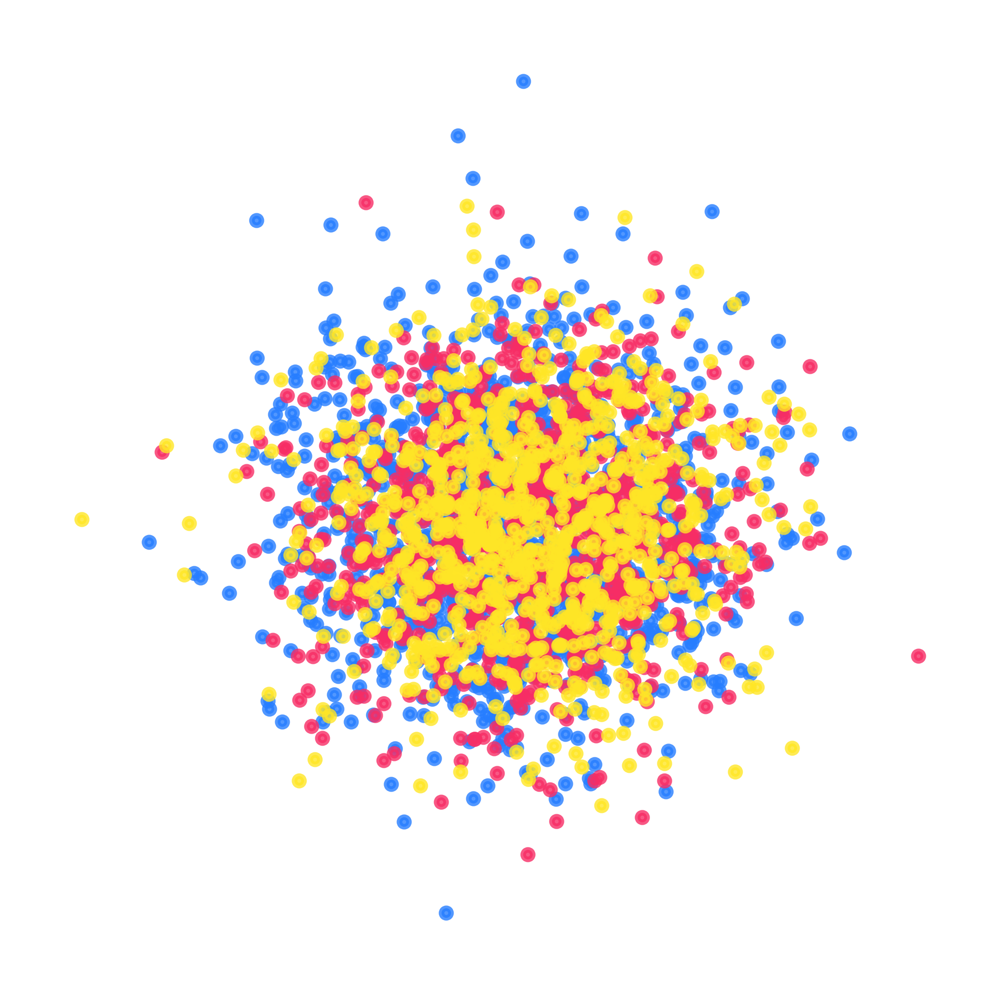

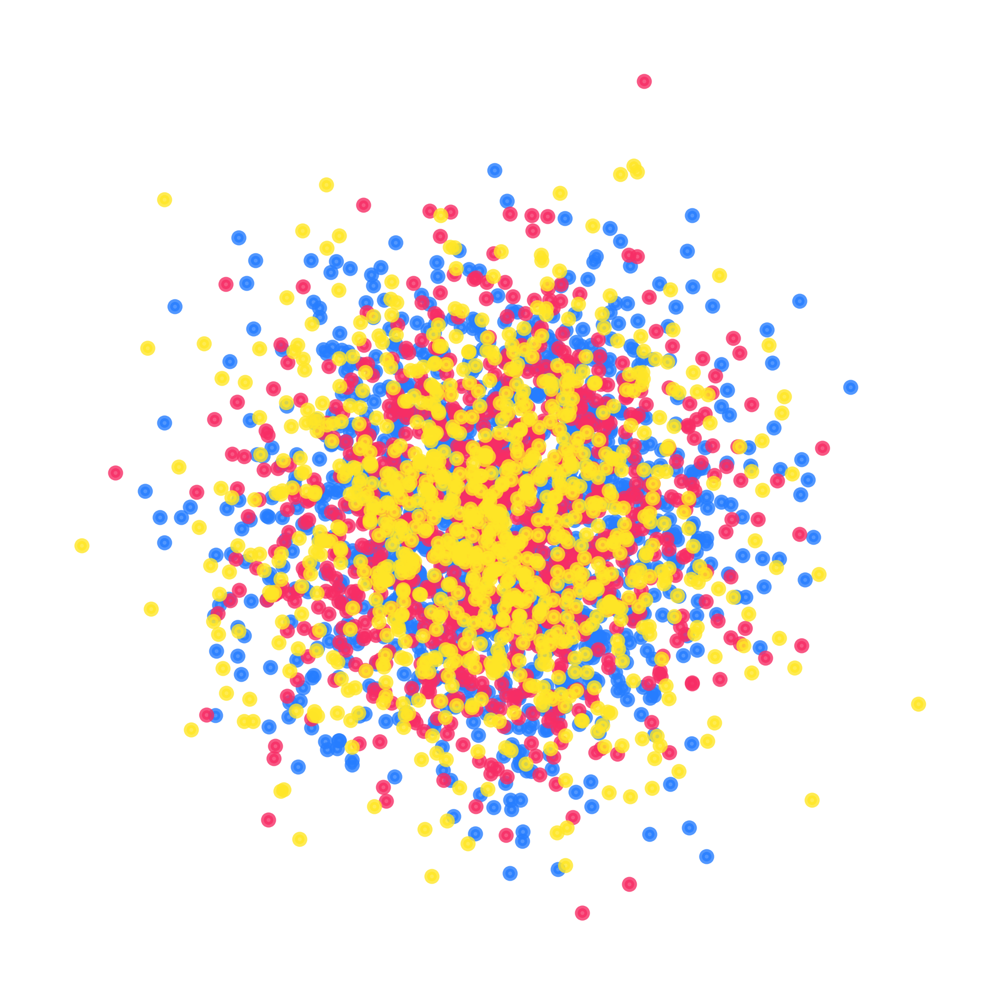

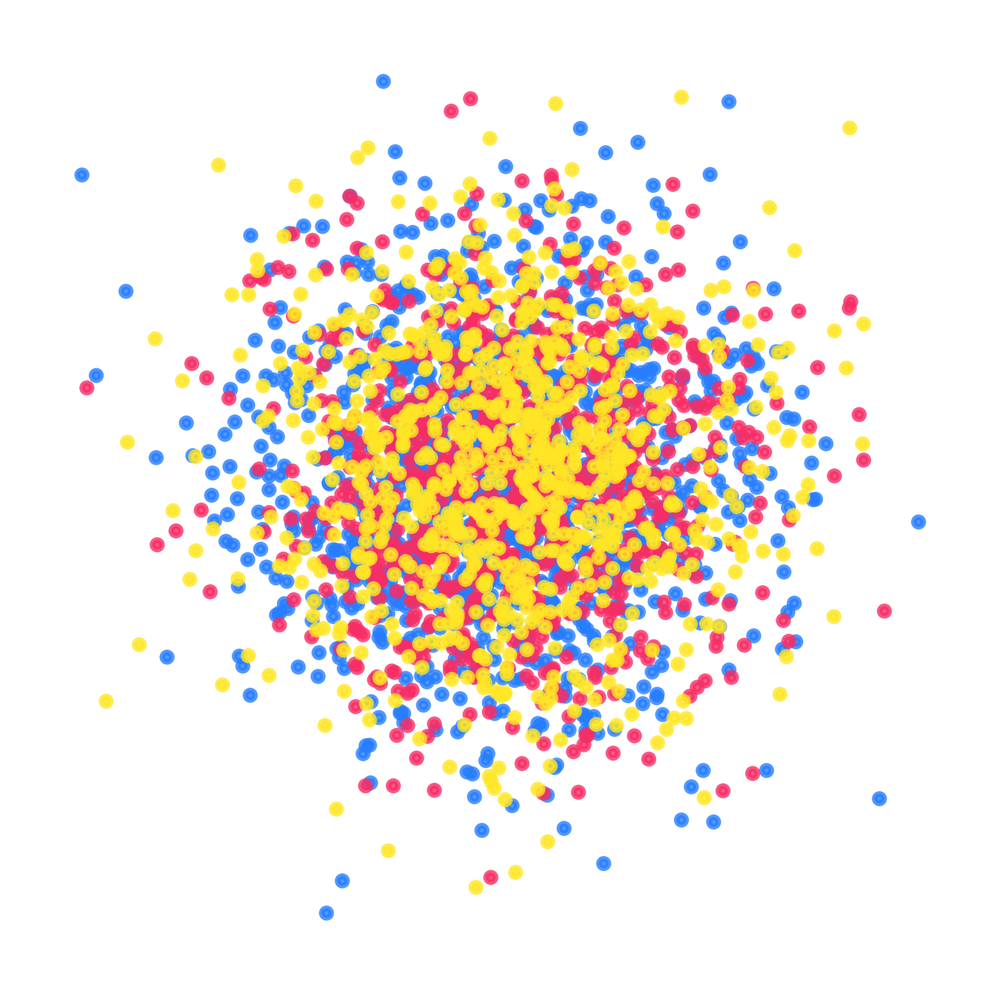

<Figure size 900x900 with 0 Axes>

In [47]:

# Function to visualize the diffusion process like in your image
def plot_diffusion(samples, time_steps=[0, 100, 200, 400, 600, 999]):
    
    for i, step in enumerate(time_steps):

        data = samples[step].detach().cpu()
        plot_embed(data,size = 3, alpha=0.8)
    plt.tight_layout()
    plt.show()

plot_diffusion(result['sample_t'])


In [16]:
logger.log("sampling...")
sample_fn = (diffusion.p_sample_loop if not args['use_ddim'] else diffusion.ddim_sample_loop)


sample_interp = sample_fn(
                    model,
                    shape = (3000, args['gene_size']),
                    clip_denoised=args['clip_denoised'],
                    model_kwargs={
                        'z_mod': z_sem
                    },
                    noise =  None
)

sampling...


In [17]:
import scipy
import torch
from sklearn.metrics import r2_score,r2_score
def cal_metric(x1,x2):
    r2 = r2_score(x1, x2)
    pearsonr,_ = scipy.stats.pearsonr(x1,x2)
    print('r2=',r2)
    print('pearsonr=',pearsonr)
    return r2, pearsonr
cal_metric(sample_interp.detach().cpu().numpy()[label==1].flatten(), data[0][label==1].X.flatten())
cal_metric(sample_interp.detach().cpu().numpy()[label==2].flatten(), data[0][label==2].X.flatten())
cal_metric(sample_interp.detach().cpu().numpy()[label==0].flatten(), data[0][label==0].X.flatten())

r2= 0.9928566217422485
pearsonr= 0.9964644339854029
r2= 0.994209349155426
pearsonr= 0.9971294996609206
r2= 0.9938730597496033
pearsonr= 0.9969690096832072


(0.9938730597496033, 0.9969690096832072)

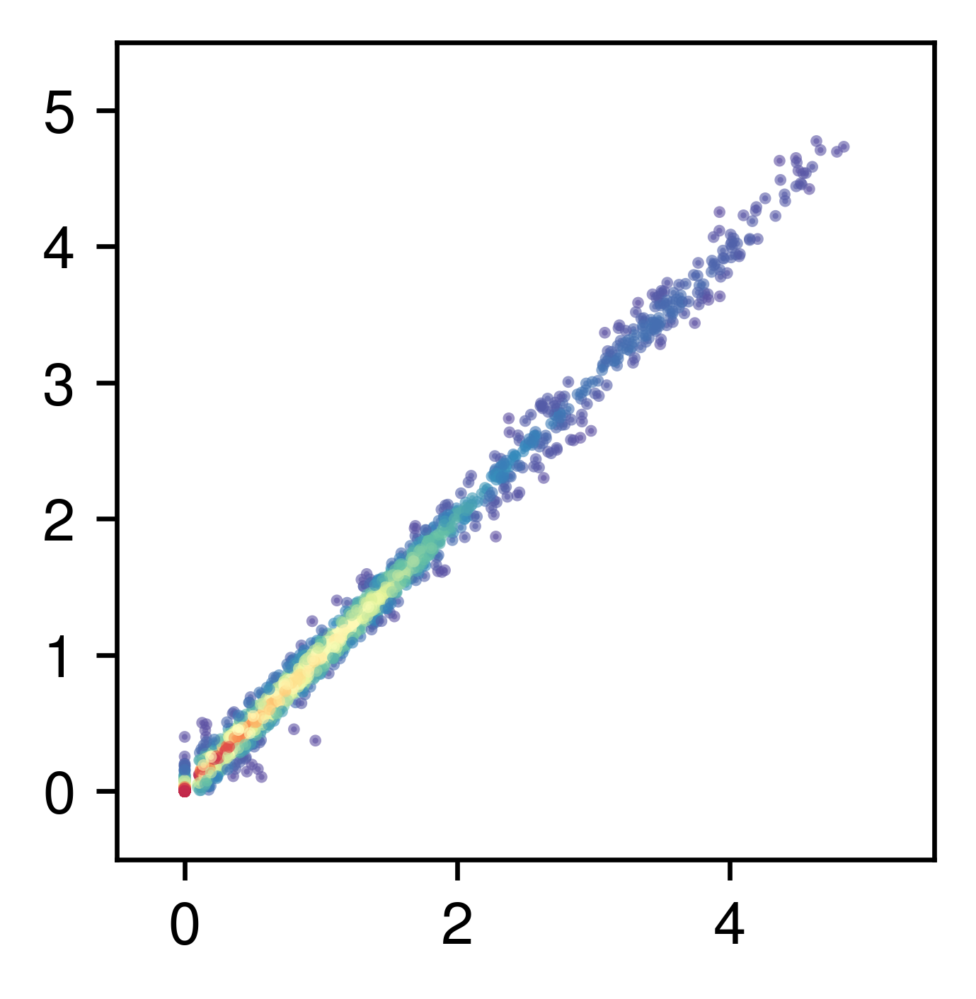

In [190]:
from scipy.stats import gaussian_kde
def display_reconst(df_true,
                    df_pred,
                    density=False,
                    den_all = False,
                    marker_genes=None,
                    sample_rate=0.1,
                    size=(4, 3.5),
                    spot_size=1,
                    title=None,
                    x_label='',
                    y_label='',
                    ):
    """
    Scatter plot - raw gexp vs. reconstructed gexp
    """
    assert 0 < sample_rate <= 1, \
        "Invalid downsampling rate for reconstruct scatter plot: {}".format(sample_rate)

    if marker_genes is not None:
        marker_genes = set(marker_genes)

    df_true_sample = df_true.sample(frac=sample_rate, random_state=0)
    df_pred_sample = df_pred.loc[df_true_sample.index]

    plt.rcParams["figure.figsize"] = size
    plt.figure(dpi=600)
    ax = plt.gca()

    xx = df_true_sample.T.to_numpy().flatten()
    yy = df_pred_sample.T.to_numpy().flatten()

    if density and not den_all:
        for gene in df_true_sample.columns:
            try:
                gene_true = df_true_sample[gene].values
                gene_pred = df_pred_sample[gene].values
                gexp_stacked = np.vstack([df_true_sample[gene].values, df_pred_sample[gene].values])

                z = gaussian_kde(gexp_stacked)(gexp_stacked)
                ax.scatter(gene_true, gene_pred, c=z,vmin=0,cmap='Spectral_r',
                           s=spot_size, alpha=0.6)
            except np.linalg.LinAlgError as e:
                pass

    elif marker_genes is not None:
        color_dict = {True: 'red', False: 'green'}
        gene_colors = np.vectorize(
            lambda x: color_dict[x in marker_genes]
        )(df_true_sample.columns)
        colors = np.repeat(gene_colors, df_true_sample.shape[0])

        ax.scatter(xx, yy, c=colors, s=spot_size, alpha=0.5)

    elif density and den_all:
        gene_true = df_true_sample.values.flatten()
        gene_pred = df_pred_sample.values.flatten()
        gexp_stacked = np.vstack([df_true_sample.values.flatten(), df_pred_sample.values.flatten()])
        z = gaussian_kde(gexp_stacked)(gexp_stacked)
        ax.scatter(gene_true, gene_pred, c=z,vmin=0,cmap='Spectral_r',
                           s=spot_size, alpha=0.99)
    else:
        ax.scatter(xx, yy, s=spot_size, alpha=0.99)
    
    
        
    min_val = min(xx.min(), yy.min())
    max_val = max(xx.max(), yy.max())
    #ax.set_xlim(min_val, 400)
    
    #ax.set_ylim(min_val, 400)
    ax.set_aspect('equal',adjustable='box')
    #ax.axis('equal')
    
    plt.suptitle(title)
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    ax.set_xlim(-0.5, 5.5)
    ax.set_ylim(-0.5, 5.5)

    plt.show()
    
    
sample_size = 20000  # Adjust the sample size as needed
indices = np.random.choice(len(data[0][label==1].X.flatten()), sample_size, replace=False)
original_sample = data[0][label==1].X.flatten()[indices]
reconstructed_sample = sample_interp.detach().cpu()[label==1].flatten()[indices]

original_df = pd.DataFrame(original_sample)
reconstructed_df = pd.DataFrame(reconstructed_sample)

# Display the plot
display_reconst(original_df, 
                reconstructed_df, 
                density=True, 
                size=(2.5,2.5))


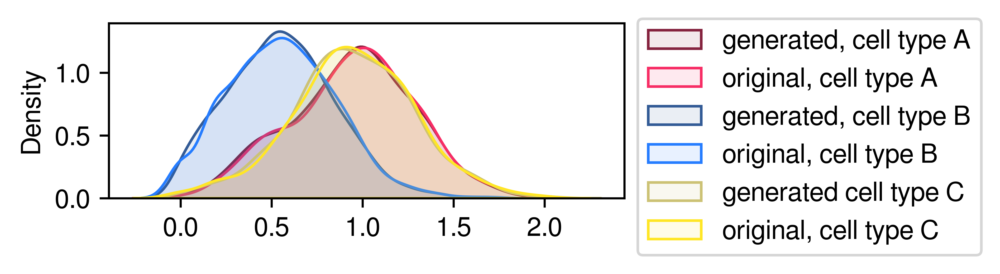

In [216]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

colorlist = ['#ffe626', '#267dff', '#f72d65'] 
colorlist = ['#CCC275', '#335B96', '#85233F'] 

# Plot smoothed distribution of the first component for label == 1
plt.figure(figsize=(3.5, 1.2), dpi=800)
# Plot for sample_interp
gene_id = 0
sns.kdeplot(sample_interp.detach().cpu()[label == 2][:, gene_id], 
            label='generated, cell type A',shade=True, alpha=0.1, color = '#85233F')
# Plot for data
sns.kdeplot(data[0].X[label == 2][:, gene_id], 
            label='original, cell type A',shade=True, alpha=0.1,  color = '#f72d65')

sns.kdeplot(sample_interp.detach().cpu()[label == 1][:, gene_id], 
            label='generated, cell type B',shade=True, alpha=0.1, color = '#335B96')
# Plot for data
sns.kdeplot(data[0].X[label == 1][:, gene_id], 
            label='original, cell type B',shade=True, alpha=0.1,  color = '#267dff')


sns.kdeplot(sample_interp.detach().cpu()[label == 0][:, gene_id], color = '#CCC275',
            label='generated cell type C',shade=True, alpha=0.1)
# Plot for data
sns.kdeplot(data[0].X[label == 0][:, gene_id], 
            label='original, cell type C',shade=True, alpha=0.1,   color = '#ffe626')


plt.legend(bbox_to_anchor=(1,1.1))
plt.show()

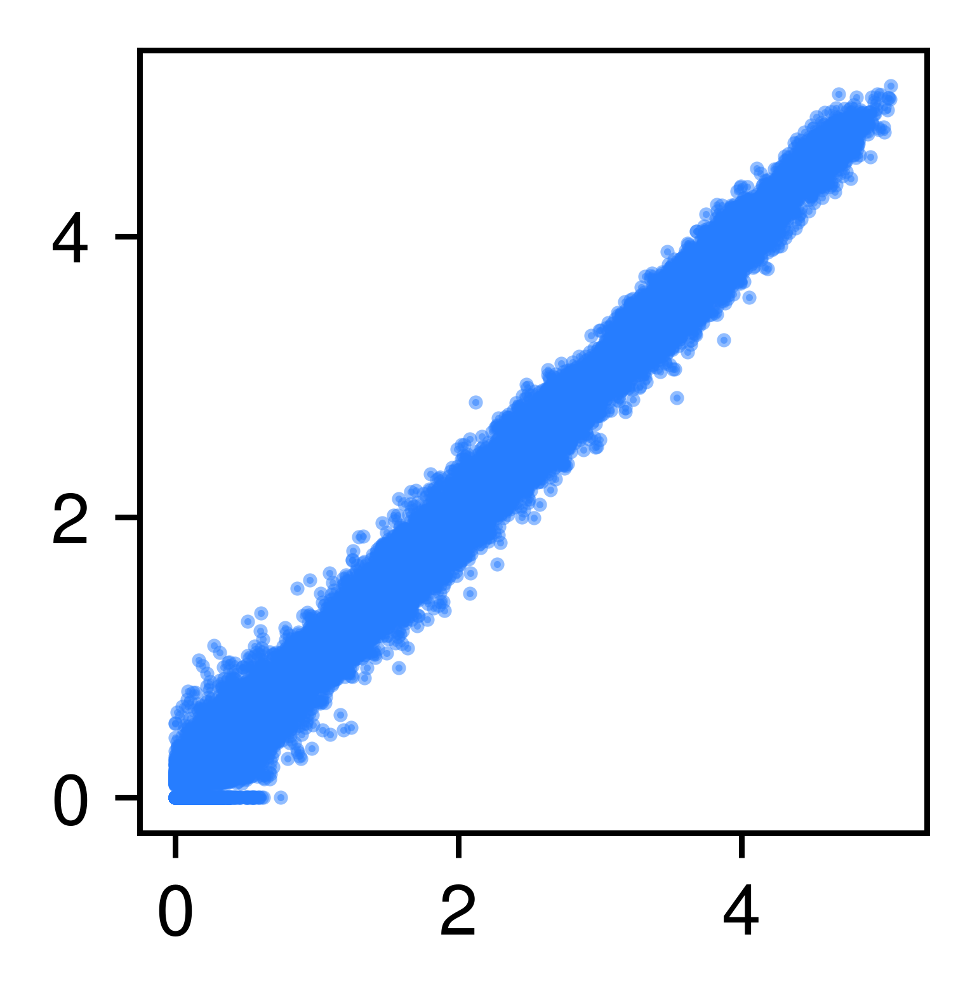

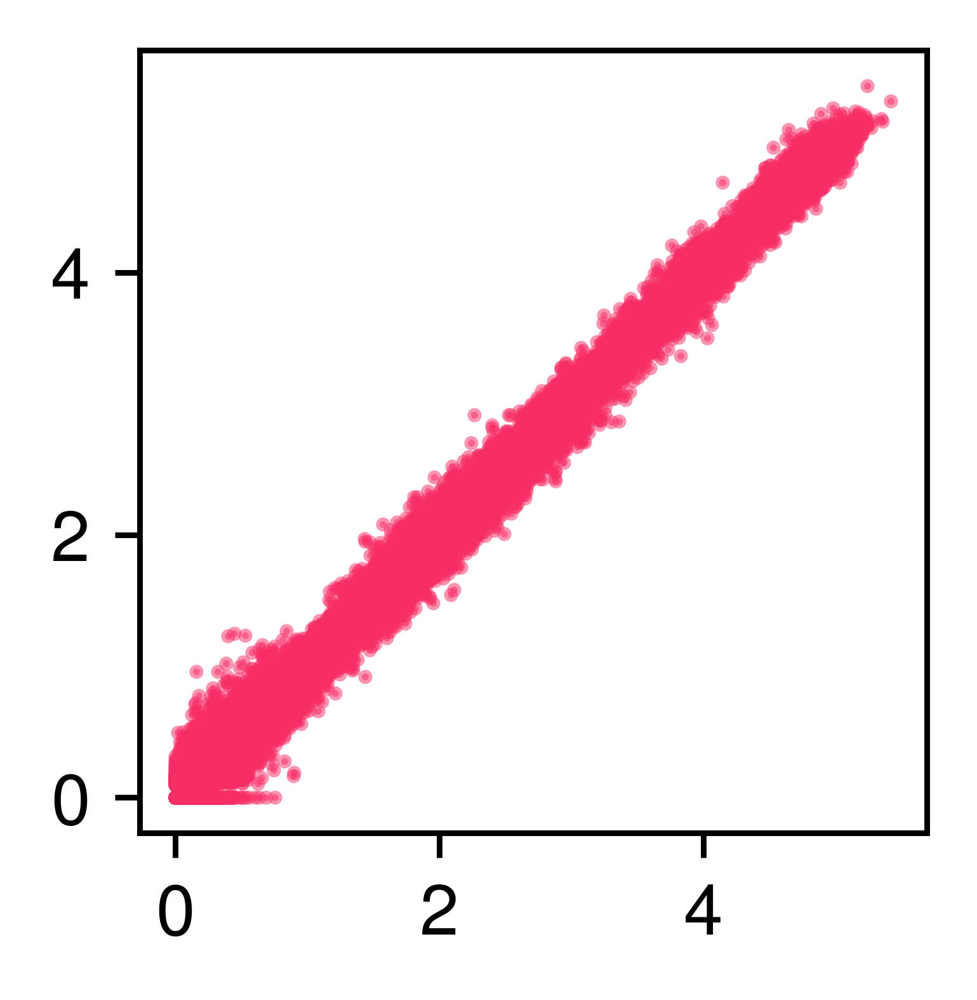

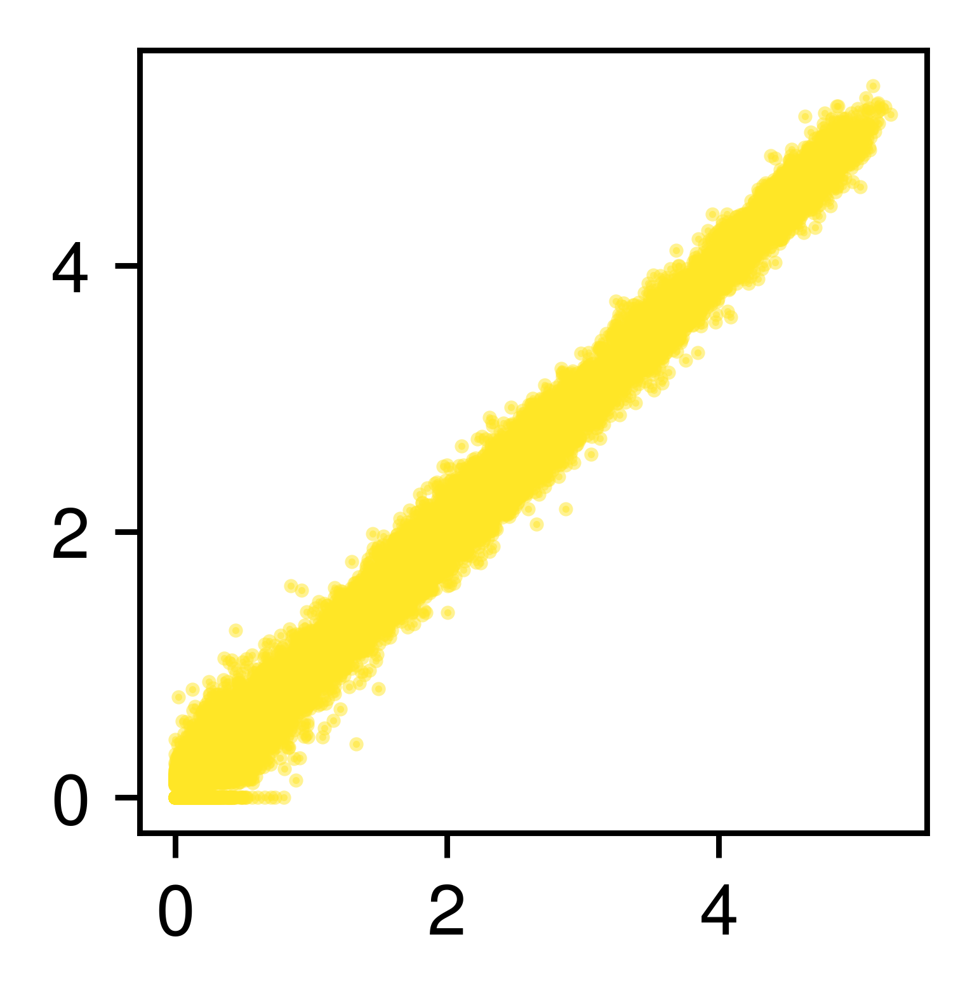

In [177]:
colorlist = ['#ffe626', '#267dff', '#f72d65'] 

plt.subplots(1,1,figsize=(2,2),dpi=800)
plt.scatter(sample_interp.detach().cpu()[label==1].flatten(),
            data[0][label==1].X.flatten(),
            s=1,
            alpha=0.5,
            c=colorlist[1]
           )

plt.subplots(1,1,figsize=(2,2),dpi=800)
plt.scatter(sample_interp.detach().cpu()[label==2].flatten(),
            data[0][label==2].X.flatten(),
            s=1,
            alpha=0.5,
            c=colorlist[2]
           )

plt.subplots(1,1,figsize=(2,2),dpi=800)
plt.scatter(sample_interp.detach().cpu()[label==0].flatten(),
            data[0][label==0].X.flatten(),
            s=1,
            alpha=0.5,
            c=colorlist[0]
           )


In [24]:
directions = np.random.randn(60)

# Scale factor for the direction vector (optional)
scale = 1

# Add the direction vector based on the label to each point in z_sem
z_sem_transformed = z_sem.detach().cpu() + scale * directions

logger.log("sampling...")
sample_fn = (diffusion.p_sample_loop if not args['use_ddim'] else diffusion.ddim_sample_loop)


sample_interp_transformed = sample_fn(
                    model,
                    shape = (3000, args['gene_size']),
                    clip_denoised=args['clip_denoised'],
                    model_kwargs={
                        'z_mod': torch.tensor(z_sem_transformed,dtype=torch.float32).to('cuda')
                    },
                    noise =  None
)

sampling...


(0.0, 10.0)

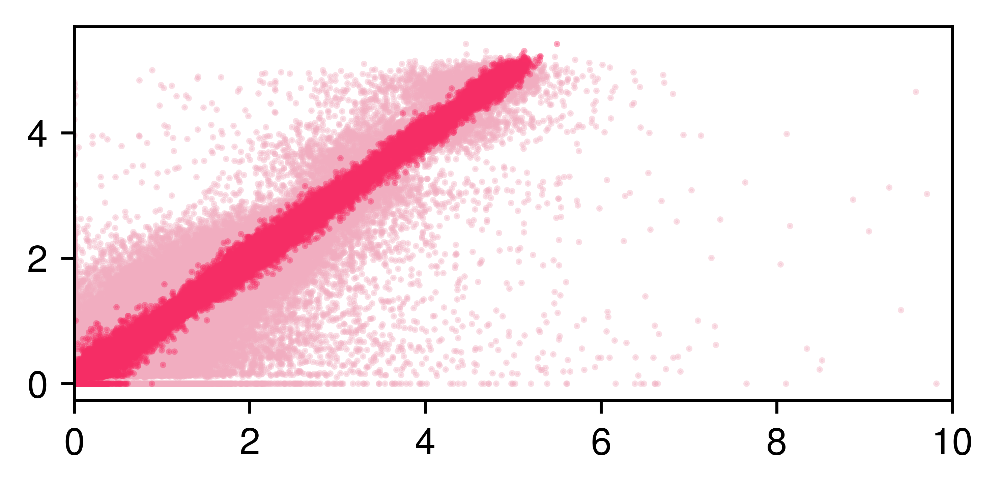

In [25]:
plt.subplots(1,1,figsize=(4.2,1.8),dpi=800)

plt.scatter(sample_interp_transformed.detach().cpu()[label==2].flatten(),
            data[0][label==2].X.flatten(),
            s=0.5,
            alpha=0.4,
            c='#F1ADC0',
            
           )
plt.scatter(sample_interp.detach().cpu()[label==2].flatten(),
            data[0][label==2].X.flatten(),
            s=0.5,
            alpha=0.4,
            c='#f72d65'
           )
plt.xlim([0.,10])

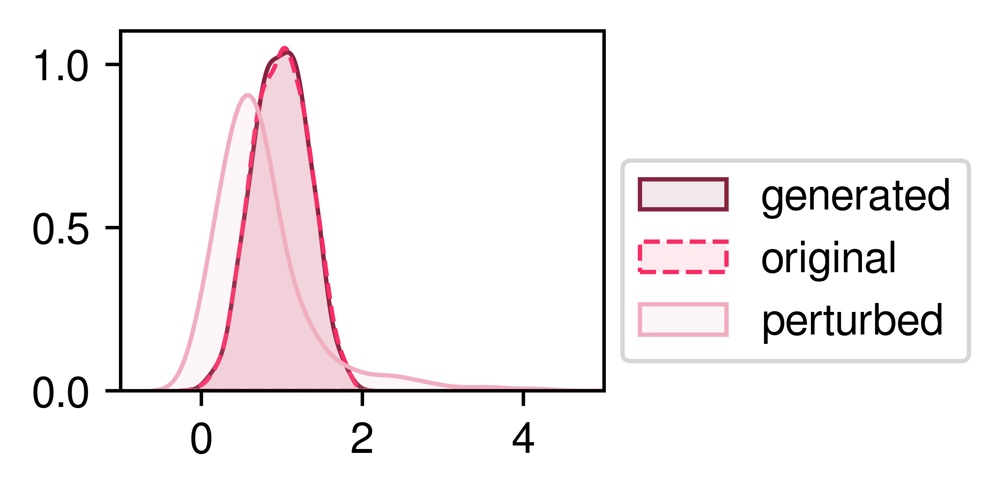

In [38]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

colorlist = ['#ffe626', '#267dff', '#f72d65'] 
colorlist = ['#CCC275', '#335B96', '#85233F'] 

# Plot smoothed distribution of the first component for label == 1
plt.figure(figsize=(2, 1.5), dpi=800)
# Plot for sample_interp
gene_id = 2
sns.kdeplot(sample_interp.detach().cpu()[label == 2][:, gene_id], 
            label='generated',shade=True, alpha=0.1, color = '#85233F')
# Plot for data
kde_original = sns.kdeplot(data[0].X[label == 2][:, gene_id], linestyle='--',
            label='original',shade=True, alpha=0.1,  color = '#f72d65')

sns.kdeplot(sample_interp_transformed.detach().cpu()[label == 2][:, gene_id], 
            label='perturbed',shade=True, alpha=0.1, color = '#F1ADC0')
plt.xlim([-1.,5])
plt.legend(bbox_to_anchor=(1.8,0.7))
plt.ylabel('')
plt.show()


In [232]:
z_sem.detach().cpu()

tensor([[-0.5864,  0.3775,  0.1788,  ...,  0.6776,  0.1253, -0.4957],
        [ 0.0037,  1.1115,  0.1652,  ..., -0.7989, -0.2388,  0.8354],
        [-0.0141, -0.2566, -0.2619,  ...,  0.5066,  0.0124, -0.4434],
        ...,
        [-0.4979, -0.2507,  0.9197,  ..., -0.4957, -1.3733, -1.2787],
        [-0.7378, -0.0602,  0.6569,  ...,  0.0261,  0.4081, -0.5506],
        [ 0.1194, -0.7601, -0.7623,  ...,  0.7111, -0.2265, -0.1576]])

In [233]:
z_sem_transformed

tensor([[-1.1841,  0.3737,  0.1151,  ..., -1.4349, -0.7183, -1.6822],
        [-0.5940,  1.1076,  0.1015,  ..., -2.9115, -1.0824, -0.3510],
        [-0.6118, -0.2604, -0.3256,  ..., -1.6059, -0.8311, -1.6298],
        ...,
        [-1.0956, -0.2545,  0.8560,  ..., -2.6082, -2.2169, -2.4651],
        [-1.3355, -0.0640,  0.5932,  ..., -2.0864, -0.4355, -1.7370],
        [-0.4783, -0.7639, -0.8260,  ..., -1.4014, -1.0701, -1.3440]],
       dtype=torch.float64)

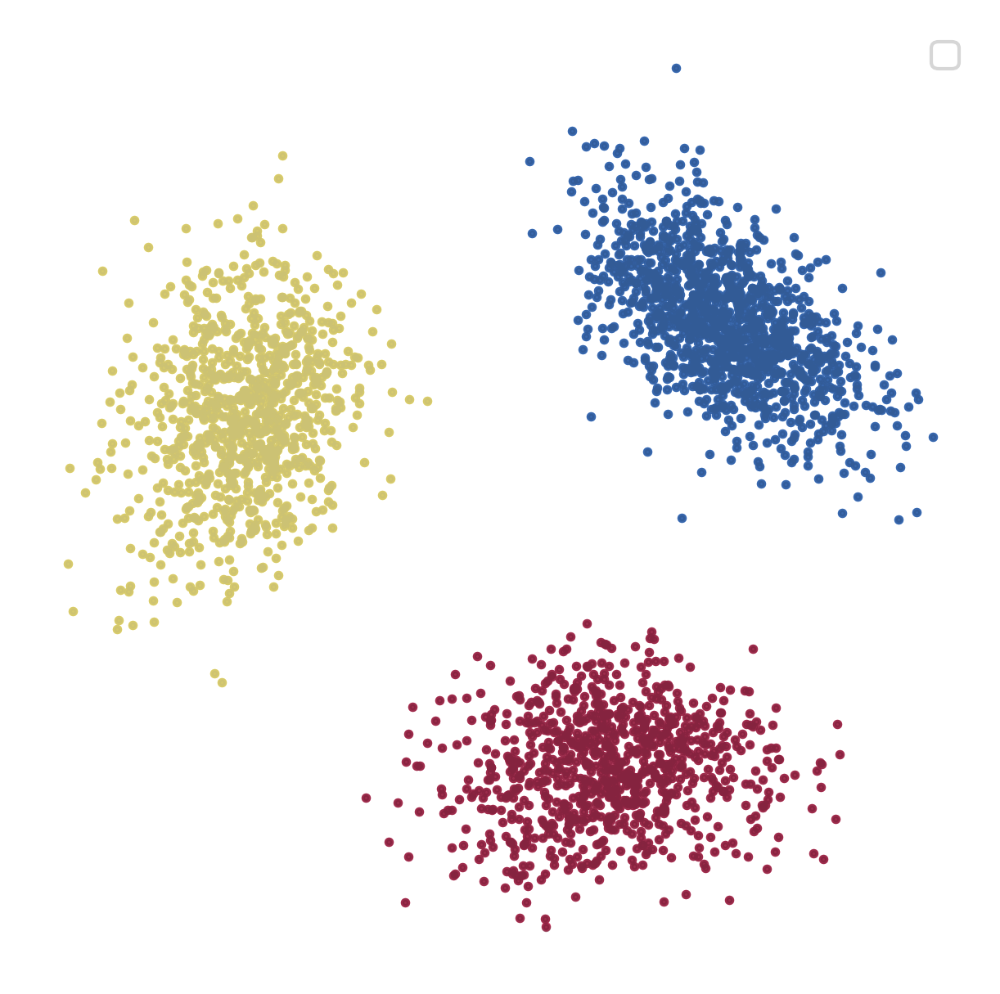

In [229]:
# Perform PCA dimensionality reduction
pca = PCA(n_components=2, random_state=42)
embedding = pca.fit_transform(z_sem.detach().cpu())

pca = PCA(n_components=2, random_state=42)
embedding_z_sem_transformed = pca.fit_transform(z_sem_transformed)

# Plot the embeddings
plt.figure(figsize=(5, 5), dpi=300)
 # Colors for different labels

size = 3
alpha=0.8
# Plot original z_sem
colorlist = ['#ffe626', '#267dff', '#f72d65'] 
plt.scatter(embedding[label == 1, 0], embedding[label == 1, 1], c=colorlist[1], s=size, alpha=alpha)
plt.scatter(embedding[label == 2, 0], embedding[label == 2, 1], c=colorlist[2], s=size, alpha=alpha)
plt.scatter(embedding[label == 0, 0], embedding[label == 0, 1], c=colorlist[0], s=size, alpha=alpha)


colorlist = ['#CCC275', '#335B96', '#85233F']  # Colors for different labels
plt.scatter(embedding_z_sem_transformed[label == 1, 0], embedding_z_sem_transformed[label == 1, 1], c=colorlist[1], s=size, alpha=alpha)
plt.scatter(embedding_z_sem_transformed[label == 2, 0], embedding_z_sem_transformed[label == 2, 1], c=colorlist[2], s=size, alpha=alpha)
plt.scatter(embedding_z_sem_transformed[label == 0, 0], embedding_z_sem_transformed[label == 0, 1], c=colorlist[0], s=size, alpha=alpha)

plt.axis('off')
plt.legend(loc='best')
plt.show()

In [327]:

def sample_around_point(point, num_samples=600, scale=0.7):
    return point + scale * np.random.randn(num_samples, point.shape[0])


z_sem_typeA = z_sem.detach().cpu().numpy()[label==2]
z_sem_typeB = z_sem.detach().cpu().numpy()[label==1]
direct_z_sem = z_sem_typeB.mean(axis=0) - z_sem_typeA.mean(axis=0)

z_sem_interp_day1 = z_sem_typeA + direct_z_sem * 1/4
z_sem_interp_day2 = z_sem_typeA + direct_z_sem * 2/4
z_sem_interp_day3 = z_sem_typeA + direct_z_sem * 3/4
z_sem_interp_day4 = z_sem_typeA + direct_z_sem * 4/4        

In [328]:
sample_interp_A= sample_fn(
                    model,
                    shape = (881, args['gene_size']),
                    clip_denoised=args['clip_denoised'],
                    model_kwargs={
                        'z_mod': torch.tensor(z_sem_typeA,dtype=torch.float32).to('cuda')
                    },
                    noise =  None
)
sample_interp_day1 = sample_fn(
                    model,
                    shape = (881, args['gene_size']),
                    clip_denoised=args['clip_denoised'],
                    model_kwargs={
                        'z_mod': torch.tensor(z_sem_interp_day1,dtype=torch.float32).to('cuda')
                    },
                    noise =  None
)

sample_interp_day2 = sample_fn(
                    model,
                    shape = (881, args['gene_size']),
                    clip_denoised=args['clip_denoised'],
                    model_kwargs={
                        'z_mod': torch.tensor(z_sem_interp_day2,dtype=torch.float32).to('cuda')
                    },
                    noise =  None
)

sample_interp_day3 = sample_fn(
                    model,
                    shape = (881, args['gene_size']),
                    clip_denoised=args['clip_denoised'],
                    model_kwargs={
                        'z_mod': torch.tensor(z_sem_interp_day3,dtype=torch.float32).to('cuda')
                    },
                    noise =  None
)

sample_interp_day4 = sample_fn(
                    model,
                    shape = (881, args['gene_size']),
                    clip_denoised=args['clip_denoised'],
                    model_kwargs={
                        'z_mod': torch.tensor(z_sem_interp_day4,dtype=torch.float32).to('cuda')
                    },
                    noise =  None
)


sample_interp_B = sample_fn(
                    model,
                    shape = (1232, args['gene_size']),
                    clip_denoised=args['clip_denoised'],
                    model_kwargs={
                        'z_mod': torch.tensor(z_sem_typeB,dtype=torch.float32).to('cuda')
                    },
                    noise =  None
)

In [341]:
import umap
inter = sample_interp_day3
# Combine all the datasets into one before fitting UMAP
combined_data = np.concatenate([
    sample_interp_A.detach().cpu(), 
    sample_interp_day1.detach().cpu(),
    sample_interp_day2.detach().cpu(),
    sample_interp_day3.detach().cpu(),
    sample_interp_day4.detach().cpu(),
    sample_interp_B.detach().cpu()
])

# Fit UMAP once on the combined data
#reducer = umap.UMAP(n_neighbors=30, min_dist=0.2, n_components=2, random_state=42)
#combined_embedding = reducer.fit_transform(combined_data)
pca = PCA(n_components=2, random_state=42)
combined_embedding = pca.fit_transform(combined_data)




# Split the embedding back into separate components
n_A = len(sample_interp[label == 2])
n_1 = len(sample_interp_day1)
n_2 = len(sample_interp_day2)
n_3 = len(sample_interp_day3)
n_4 = len(sample_interp_day4)
n_B = len(sample_interp[label == 1])

embedding_A = combined_embedding[:n_A]
embedding_1 = combined_embedding[n_A:n_A+n_1]
embedding_2 = combined_embedding[n_A+n_1:n_A+n_1+n_2]
embedding_3 = combined_embedding[n_A+n_1+n_2:n_A+n_1+n_2+n_3]
embedding_4 = combined_embedding[n_A+n_1+n_2+n_3:n_A+n_1+n_2+n_3+n_4]
embedding_B = combined_embedding[n_A+n_1+n_2+n_3+n_4:]



In [339]:
import umap
inter = sample_interp_day3
# Combine all the datasets into one before fitting UMAP
combined_data = np.concatenate([
    sample_interp_A.detach().cpu(), 
    #sample_interp_day1.detach().cpu(),
    #sample_interp_day2.detach().cpu(),
    #sample_interp_day3.detach().cpu(),
    sample_interp_day4.detach().cpu(),
    sample_interp_B.detach().cpu()
])

# Fit UMAP once on the combined data
reducer = umap.UMAP(n_neighbors=30, min_dist=0.2, n_components=2, random_state=42)
combined_embedding = reducer.fit_transform(combined_data)

# Split the embedding back into separate components
n_A = len(sample_interp[label == 2])
#n_1 = len(sample_interp_day1)
#n_2 = len(sample_interp_day2)
#n_3 = len(sample_interp_day3)
n_4 = len(sample_interp_day4)
n_B = len(sample_interp[label == 1])

embedding_A = combined_embedding[:n_A]
#embedding_1 = combined_embedding[n_A:n_A+n_1]
#embedding_2 = combined_embedding[n_A+n_1:n_A+n_1+n_2]
#embedding_3 = combined_embedding[n_A+n_1+n_2:n_A+n_1+n_2+n_3]
embedding_4 = combined_embedding[n_A:n_A+n_4]
embedding_B = combined_embedding[n_A+n_4:]


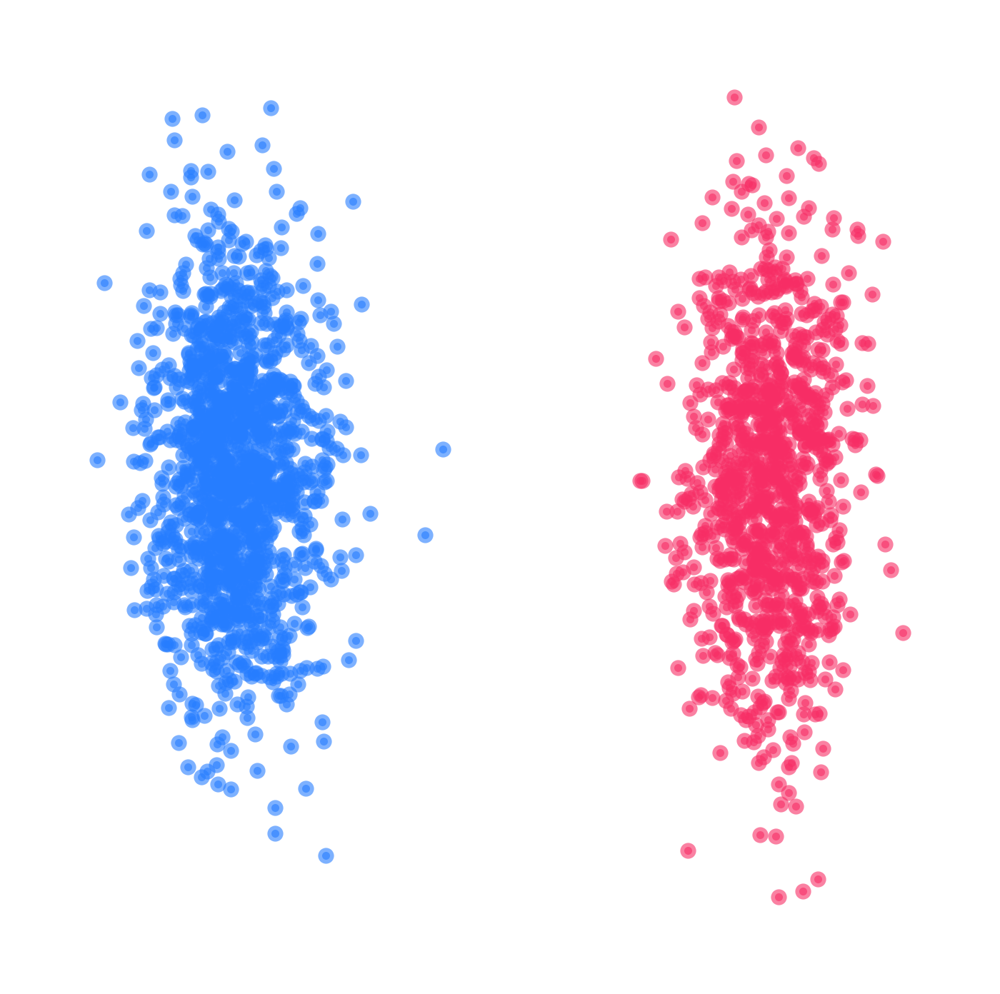

In [342]:
plt.figure(figsize=(2,2),dpi=800)
size = 1
plt.scatter(embedding_A[:, 0], embedding_A[:, 1], s=size, label='type A', c='#f72d65', alpha=0.6)
#plt.scatter(embedding_1[:, 0], embedding_1[:, 1], s=size,label='interpolation 1', alpha=0.6)
plt.scatter(embedding_B[:, 0], embedding_B[:, 1], s=size,label='type B', c='#267dff', alpha=0.6)

plt.legend().remove()
plt.axis('off')
plt.show()


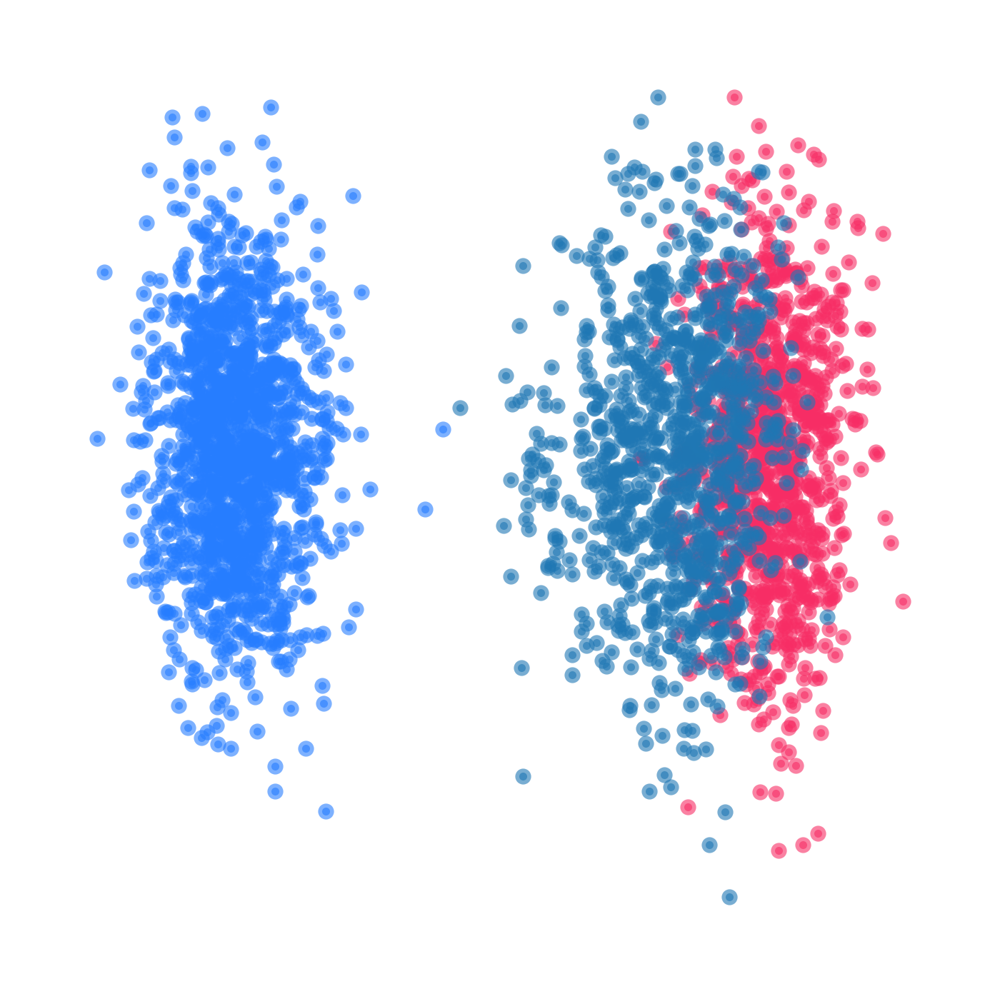

In [343]:
plt.figure(figsize=(2,2),dpi=800)
size = 1
plt.scatter(embedding_A[:, 0], embedding_A[:, 1], s=size, label='type A', c='#f72d65', alpha=0.6)
plt.scatter(embedding_1[:, 0], embedding_1[:, 1], s=size,label='interpolation 1', alpha=0.6)
plt.scatter(embedding_B[:, 0], embedding_B[:, 1], s=size,label='type B', c='#267dff', alpha=0.6)

plt.legend().remove()
plt.axis('off')
plt.show()


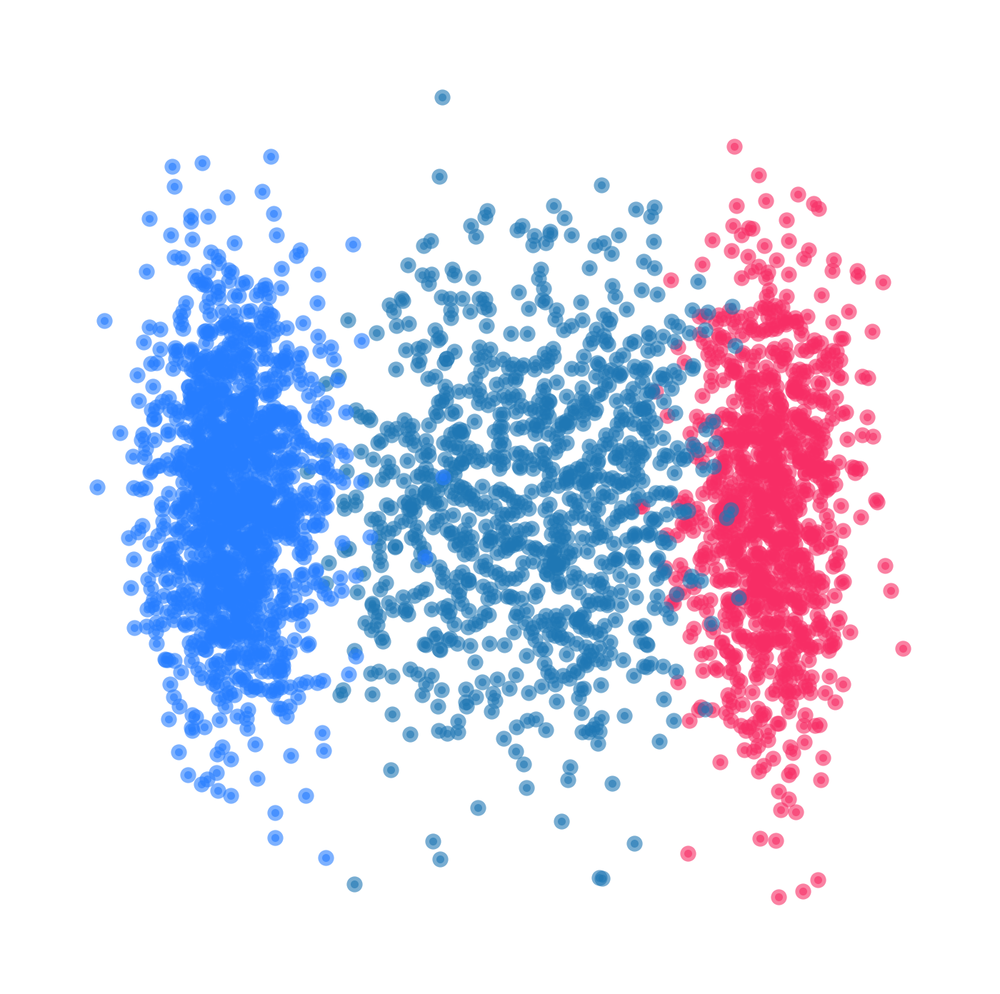

In [344]:
plt.figure(figsize=(2,2),dpi=800)
size = 1
plt.scatter(embedding_A[:, 0], embedding_A[:, 1], s=size, label='type A', c='#f72d65', alpha=0.6)
plt.scatter(embedding_2[:, 0], embedding_2[:, 1], s=size,label='interpolation 2', alpha=0.6)
plt.scatter(embedding_B[:, 0], embedding_B[:, 1], s=size,label='type B', c='#267dff', alpha=0.6)

plt.legend().remove()
plt.axis('off')
plt.show()


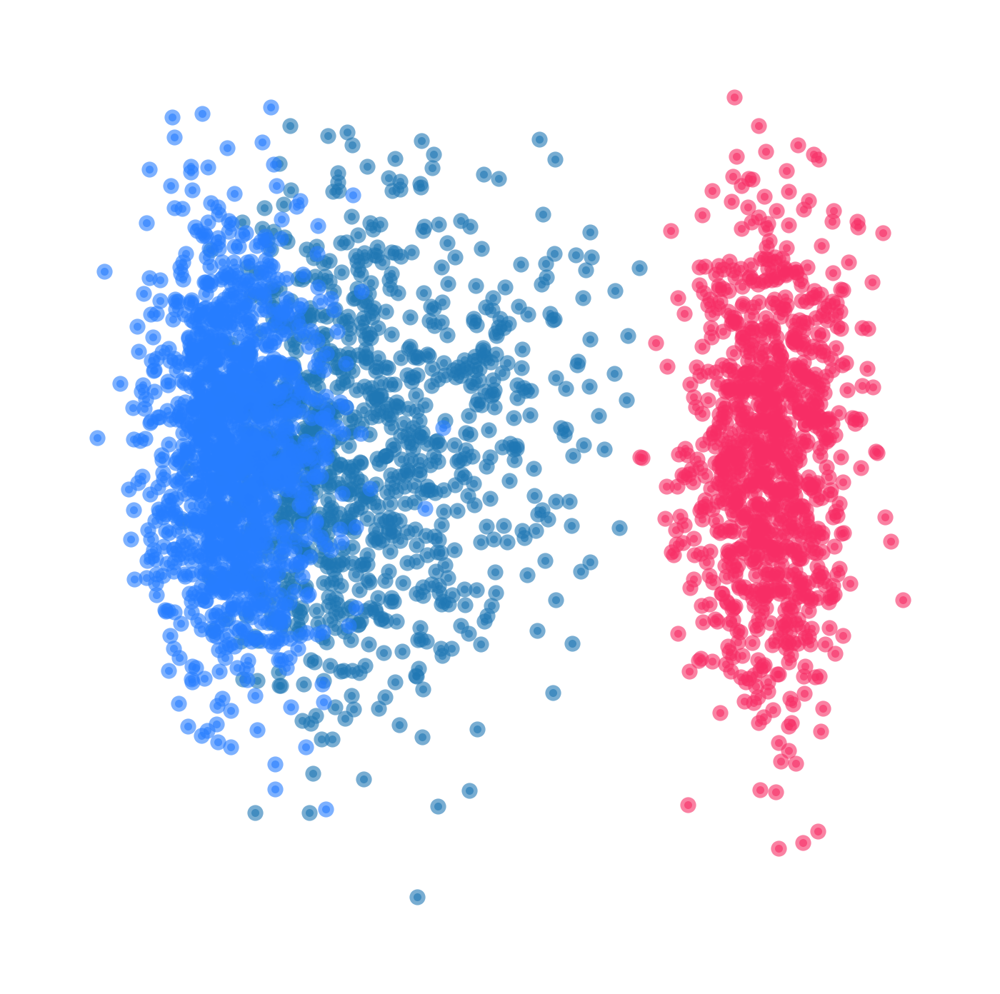

In [345]:
plt.figure(figsize=(2,2),dpi=800)
size = 1
plt.scatter(embedding_A[:, 0], embedding_A[:, 1], s=size, label='type A', c='#f72d65', alpha=0.6)
plt.scatter(embedding_3[:, 0], embedding_3[:, 1], s=size,label='interpolation 2', alpha=0.6)
plt.scatter(embedding_B[:, 0], embedding_B[:, 1], s=size,label='type B', c='#267dff', alpha=0.6)

plt.legend().remove()
plt.axis('off')
plt.show()


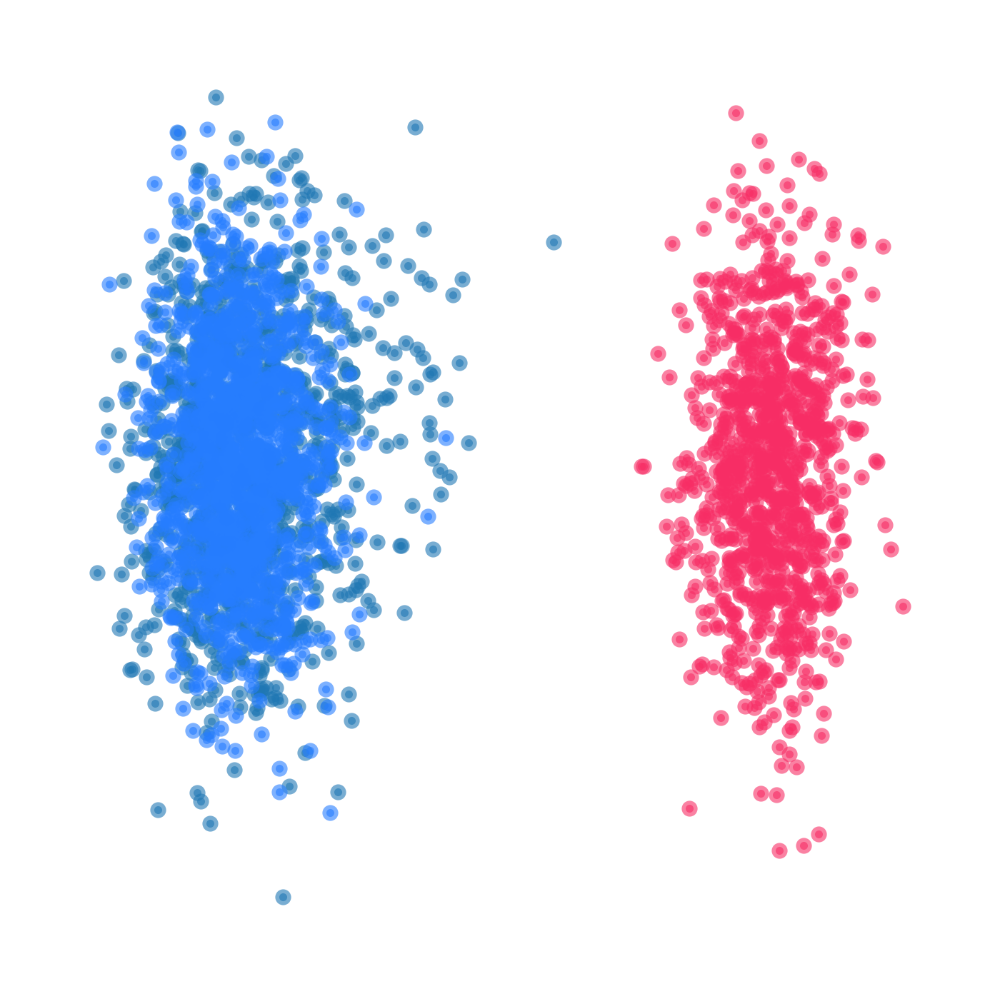

In [346]:
plt.figure(figsize=(2,2),dpi=800)
size = 1
plt.scatter(embedding_A[:, 0], embedding_A[:, 1], s=size, label='type A', c='#f72d65', alpha=0.6)
plt.scatter(embedding_4[:, 0], embedding_4[:, 1], s=size,label='interpolation 2', alpha=0.6)
plt.scatter(embedding_B[:, 0], embedding_B[:, 1], s=size,label='type B', c='#267dff', alpha=0.6)

plt.legend().remove()
plt.axis('off')
plt.show()


## recontruct process

In [9]:
# Initialize UMAP for 1D embedding
import umap
umap_reducer = umap.UMAP(n_components=1)

# Apply 1D UMAP to each tensor and store the result
umap_embeddings_recon_all = {}
for key, recon_ in merged_dict.items():
    if key % 10 == 0:
    #if (key ==600 ) | (key==1):
        print(key)
        recon_ = recon_.detach().cpu().numpy()

        # Apply UMAP
        embedding = umap_reducer.fit_transform(recon_)

        # Store the embedding
        umap_embeddings_recon_all[key] = embedding


100


Exception ignored on calling ctypes callback function: <function ExecutionEngine._raw_object_cache_notify at 0x149354050310>
Traceback (most recent call last):
  File "/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/llvmlite/binding/executionengine.py", line 178, in _raw_object_cache_notify
    def _raw_object_cache_notify(self, data):
KeyboardInterrupt: 


90
80
70
60
50
40
30


KeyboardInterrupt: 

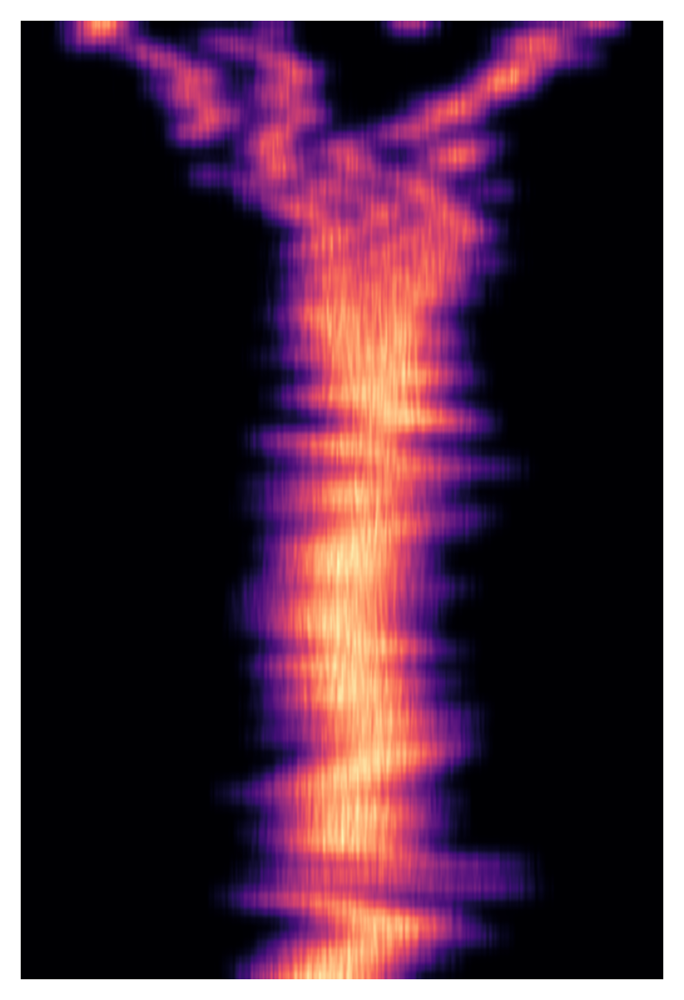

In [65]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter

# Example umap_embeddings dictionary (assuming it's already filled with UMAP results)
# umap_embeddings = {'key1': np.array([...]), 'key2': np.array([...]), ...}

# Convert umap_embeddings to a 2D array
umap_array = np.array(list(umap_embeddings_recon_all.values()))[:,:,0]

num_time_steps, num_data_points = umap_array.shape

# Define the number of bins for the histogram and the smoothing factor
num_bins = 800
sigma = 1.2  # Smoothing factor

# Create an array to store the histogram counts
histogram_counts = np.zeros((num_time_steps, num_bins))

# Define the range for the histograms
data_min, data_max = np.min(umap_array), np.max(umap_array)
#data_min = -25  # Adjust as needed
bin_edges = np.linspace(data_min, data_max, num_bins + 1)

# Compute the histogram for each set of UMAP embeddings
for i in range(num_time_steps):
    counts, _ = np.histogram(umap_array[i, :], bins=bin_edges)
    histogram_counts[i, :] = counts

# Apply Gaussian smoothing
smoothed_histogram_counts = gaussian_filter(histogram_counts, sigma=sigma)

# Plot the smoothed heatmap
plt.figure(figsize=(4, 6))
plt.imshow(smoothed_histogram_counts, aspect='auto', origin='lower',
           extent=[bin_edges[0], bin_edges[-1], 0, num_time_steps],
           cmap='magma')
plt.axis('off')
plt.show()


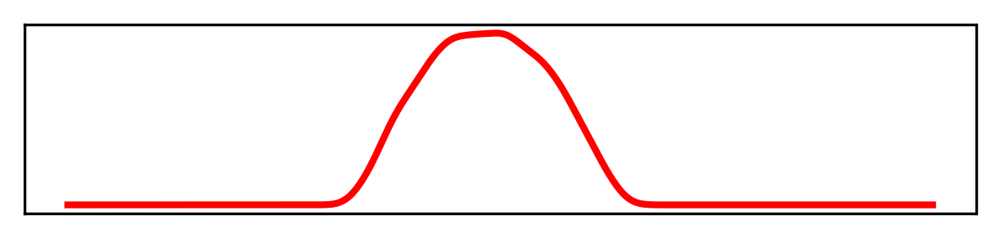

In [49]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

# Extract the first row of diffused_data
first_time_step_data = umap_embeddings_recon_all[600][:,0]

# Define the number of bins for the histogram
num_bins = 50

# Calculate the histogram
hist, bin_edges = np.histogram(first_time_step_data, bins=num_bins, density=True)
bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

# Fit KDE to the data
kde = gaussian_kde(first_time_step_data)

# Evaluate the KDE on a fine grid
kde_grid = np.linspace(data_min, data_max, 1000)
kde_values = kde(kde_grid)

# Plot the histogram and the KDE
plt.figure(figsize=(5,1))
#plt.bar(bin_centers, hist, width=bin_edges[1] - bin_edges[0], alpha=0.5, color='blue', label='Histogram')
plt.plot(kde_grid, kde_values, color='red', label='KDE',linewidth=2)
plt.yticks([])
plt.xticks([])
plt.show()

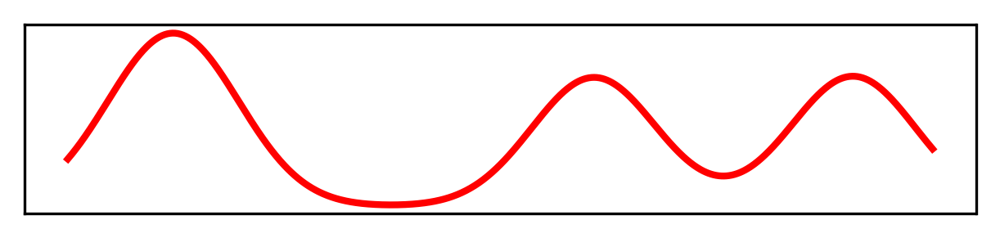

In [55]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

# Extract the first row of diffused_data
first_time_step_data = umap_embeddings_recon_all[1][:,0]

# Define the number of bins for the histogram
num_bins = 50

# Calculate the histogram
hist, bin_edges = np.histogram(first_time_step_data, bins=num_bins, density=True)
bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

# Fit KDE to the data
kde = gaussian_kde(first_time_step_data)

# Evaluate the KDE on a fine grid
kde_grid = np.linspace(data_min, data_max, 1000)
kde_values = kde(kde_grid)

# Plot the histogram and the KDE
plt.figure(figsize=(5,1))
#plt.bar(bin_centers, hist, width=bin_edges[1] - bin_edges[0], alpha=0.5, color='blue', label='Histogram')
plt.plot(kde_grid, kde_values, color='red', label='KDE',linewidth=2)
plt.yticks([])
plt.xticks([])
plt.show()

In [17]:
pd.DataFrame(original_data_list).to_csv('/hpc/mydata/siyu.he/squidward_study/results/fig1/original_data.csv')
pd.DataFrame(reconstructed_data_list).to_csv('/hpc/mydata/siyu.he/squidward_study/results/fig1/reconstructed_data.csv')



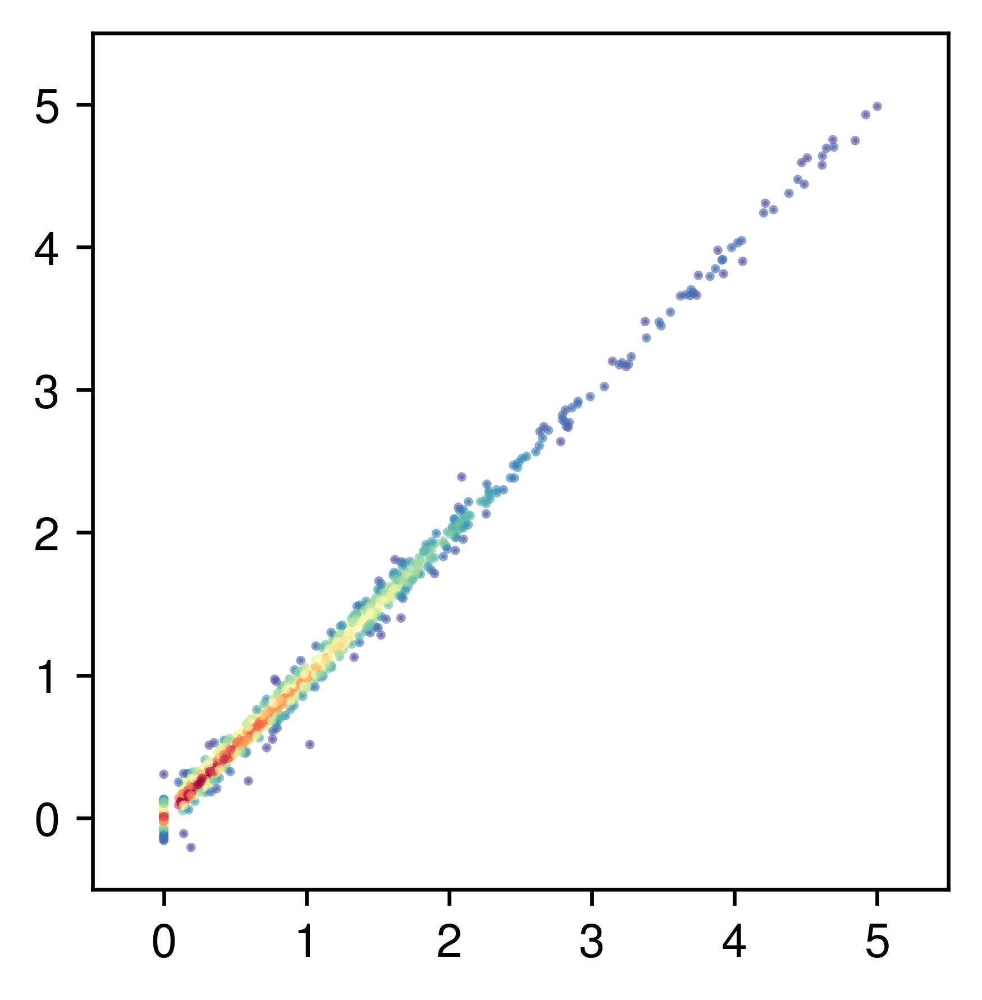

## compare pearsoner

In [48]:
sc_recon_adata = anndata.AnnData(sc_recon.copy())
sc.pp.normalize_total(sc_recon_adata, target_sum=1e4)
sc.pp.log1p(sc_recon_adata)

NameError: name 'sc_recon' is not defined

In [88]:
import scipy
from sklearn.metrics import r2_score
pearsonr_squidiff = []
for i in range(200):
    p_ , _ = scipy.stats.pearsonr((original_array[i,:]),
                     (reconstructed_data_array[i,:])
                    )
    pearsonr_squidiff.append(p_)

In [89]:
np.array(pearsonr_squidiff).mean()

0.9361891856069786

In [90]:
import scipy
from sklearn.metrics import r2_score
pearsonr_scvi = []
for i in range(200):
    p_ , _ = scipy.stats.pearsonr((np.array(adata.to_df())[i,:]),
                     (np.array(sc_recon_adata.to_df())[i,:])
                    )
    pearsonr_scvi.append(p_)

In [91]:
np.array(pearsonr_scvi).mean()

0.9173530667169983

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04



AttributeError: module 'seaborn' has no attribute 'categorical'

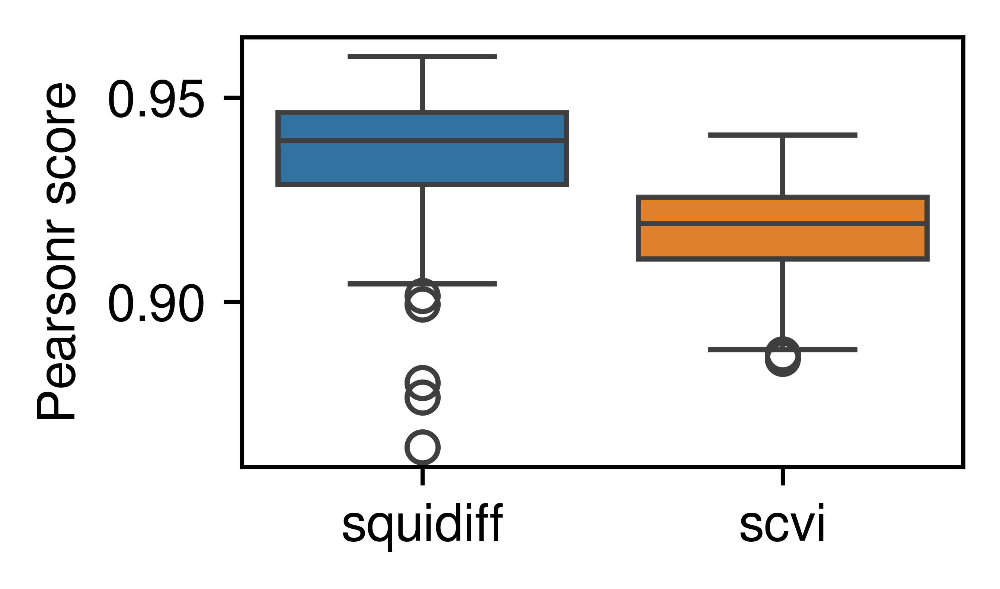

In [120]:
from statannot import add_stat_annotation
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats


all_ = pd.concat([pd.DataFrame(pearsonr_squidiff),
                  pd.DataFrame(pearsonr_scvi)],axis=1,)
all_.columns=['squidiff','scvi']

fig,ax=plt.subplots(1,1,dpi=1000,figsize=(2.5,1.5))
g1=sns.boxplot(data=all_,ax=ax)
plt.ylabel('Pearsonr score')

add_stat_annotation(g1,
                    data=all_, 
                    box_pairs=[('squidiff','scvi'),
                             
                              ],
                    test='t-test_ind', 
                    text_format='star', 
                    loc='outside', 
                    verbose=2);



In [123]:
import scipy
from sklearn.metrics import r2_score
r2_squidiff = []
for i in range(200):
    p_ = r2_score((original_array[i,:]),
                     (reconstructed_data_array[i,:])
                    )
    r2_squidiff.append(p_)

r2_scvi = []
for i in range(200):
    p_ =r2_score(np.log1p(adata.layers['counts'])[i,:],
                     np.log1p(sc_recon)[i,:]
                    )
    r2_scvi.append(p_)
#r2_score((original_array.flatten()),(reconstructed_data_array.flatten()))

In [125]:
from scipy import stats

stats.ttest_ind(pearsonr_squidiff, pearsonr_scvi)



TtestResult(statistic=14.194207231574756, pvalue=2.7327101102465888e-37, df=398.0)

In [128]:
len(r2_squidiff)

200

In [126]:
stats.ttest_ind(r2_squidiff, r2_scvi)

TtestResult(statistic=14.608192547843268, pvalue=5.325495638728526e-39, df=398.0)

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

squidiff v.s. scvi: t-test independent samples with Bonferroni correction, P_val=1.459e-27 stat=1.175e+01


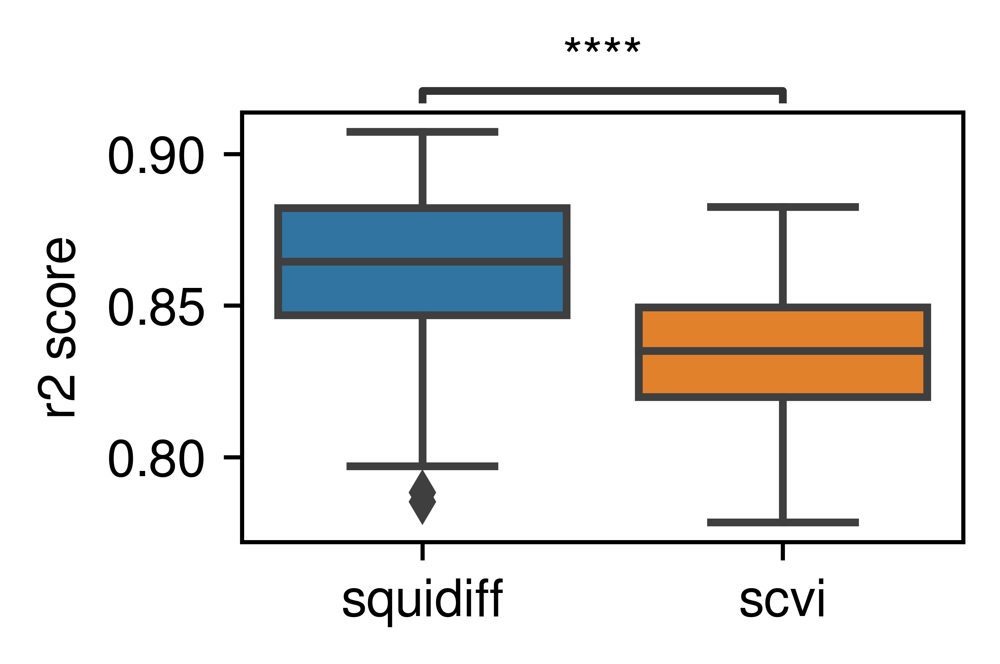

In [302]:
from matplotlib import rcParams
from statannot import add_stat_annotation
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

all_ = pd.concat([pd.DataFrame(pearsonr_squidiff),
                  pd.DataFrame(pearsonr_scvi)],axis=1,)
all_.columns=['squidiff','scvi']

fig,ax=plt.subplots(1,1,dpi=1000,figsize=(2.5,1.5))
#sns.set_theme(style="white")
g1=sns.boxplot(data=all_,ax=ax
           )
plt.ylabel('r2 score')

add_stat_annotation(g1,
                    data=all_, 
                    box_pairs=[('squidiff','scvi'),
                             
                              ],
                    
                    
                    test='t-test_ind', 
                    text_format='star', 
                    loc='outside', 
                    verbose=2);
#plt.ylim([0,2])

In [34]:
all_z_sem = []
all_x_T = []
all_type = []
T=n_time_steps-1
# Loop over all the data in the dataloader
for data, features in dataloader:
    x_0 = data.to(device)  # Move the batch to the appropriate device
    z_sem = model.semantic_encoder(x_0)  # Compute semantic encoding

    x_T = stochastic_encoder.stochastic_encode(x_0, n_time_steps)  # Compute the encoded data at final timestep
    
    all_z_sem.append(z_sem.detach().cpu().numpy())  # Collect the semantic encodings
    all_x_T.append(x_T.detach().cpu().numpy())  # Collect the final timestep encodings
    all_type.append(features[:,2:3].detach().cpu().numpy())
# Convert the list of numpy arrays to a single numpy array for UMAP
all_z_sem = np.vstack(all_z_sem)
all_x_T = np.vstack(all_x_T)
all_type = np.vstack(all_type)


In [117]:
# Define your hexadecimal color codes
import matplotlib.colors as mcolors
hex_colors = ['#ffe626', '#267dff', '#f72d65']

# Convert hexadecimal to RGB
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]

# Create a custom colormap from these colors
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)

# Testing the colormap with a simple plot


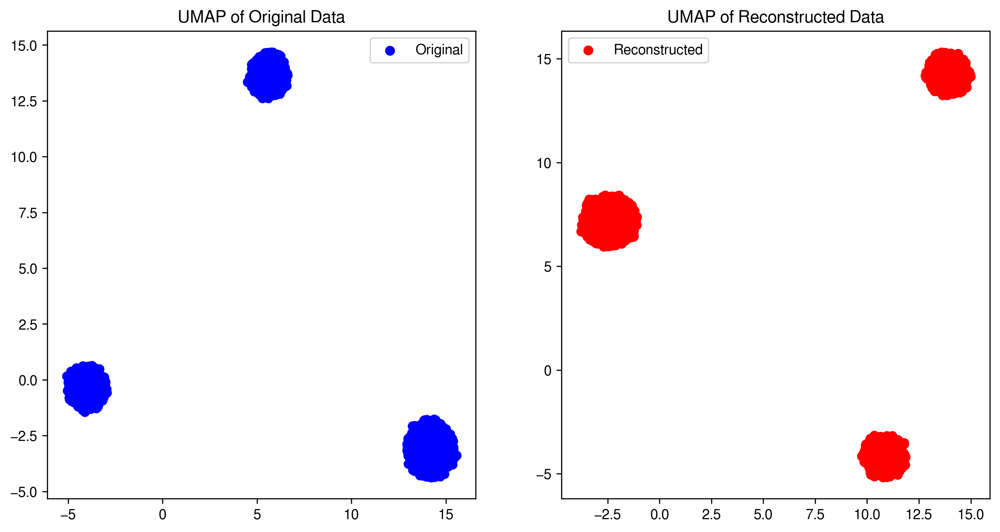

In [ ]:
import umap
import matplotlib.pyplot as plt

# Apply UMAP for dimensionality reduction
umap_model = umap.UMAP(n_components=2, random_state=42)
original_umap = umap_model.fit_transform(original_array)
reconstructed_umap = umap_model.fit_transform(reconstructed_data_array)



NameError: name 'all_type' is not defined

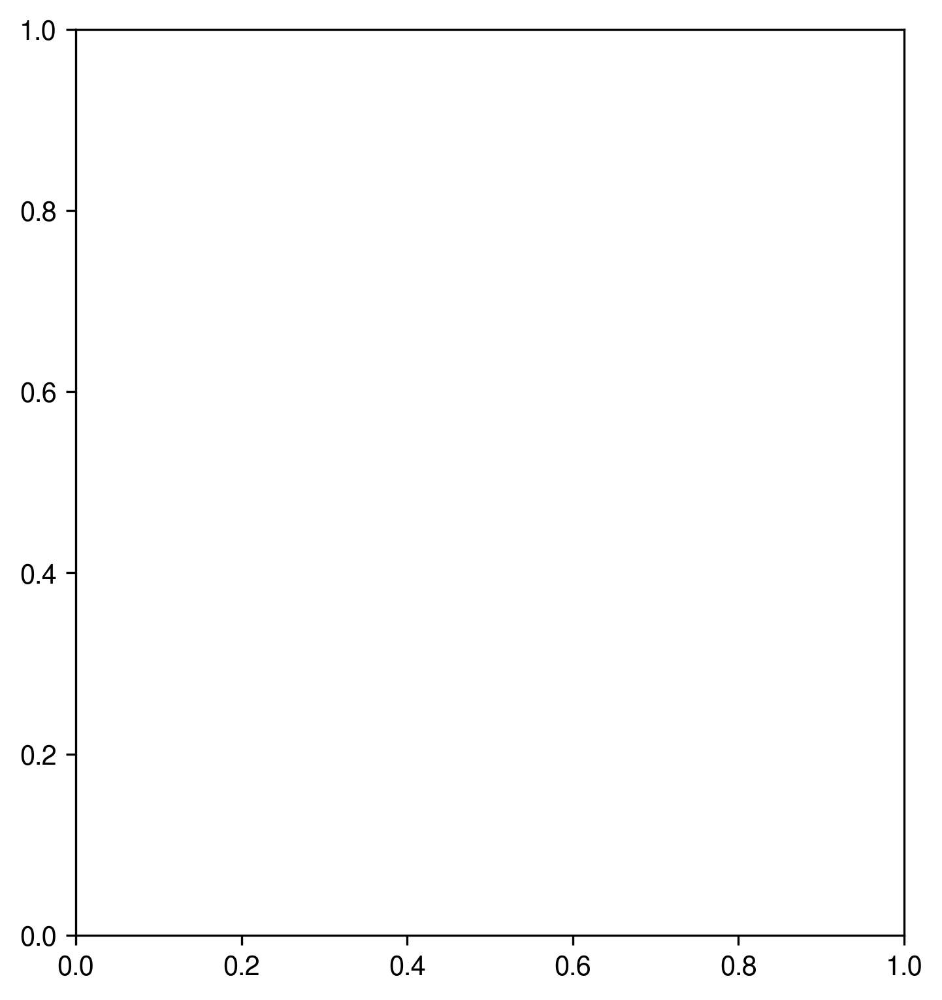

In [119]:
# Plotting the results
plt.figure(figsize=(12, 6))

# Original data
plt.subplot(1, 2, 1)
plt.scatter(original_umap[:, 0], original_umap[:, 1], c = all_type, cmap=cmap, label='Original')
plt.title('UMAP of Original Data')
plt.legend()

# Reconstructed data
plt.subplot(1, 2, 2)
plt.scatter(reconstructed_umap[:, 0], reconstructed_umap[:, 1], c = all_type, cmap=cmap, label='Reconstructed')
plt.title('UMAP of Reconstructed Data')
plt.legend()

plt.show()

NameError: name 'original_tsne' is not defined

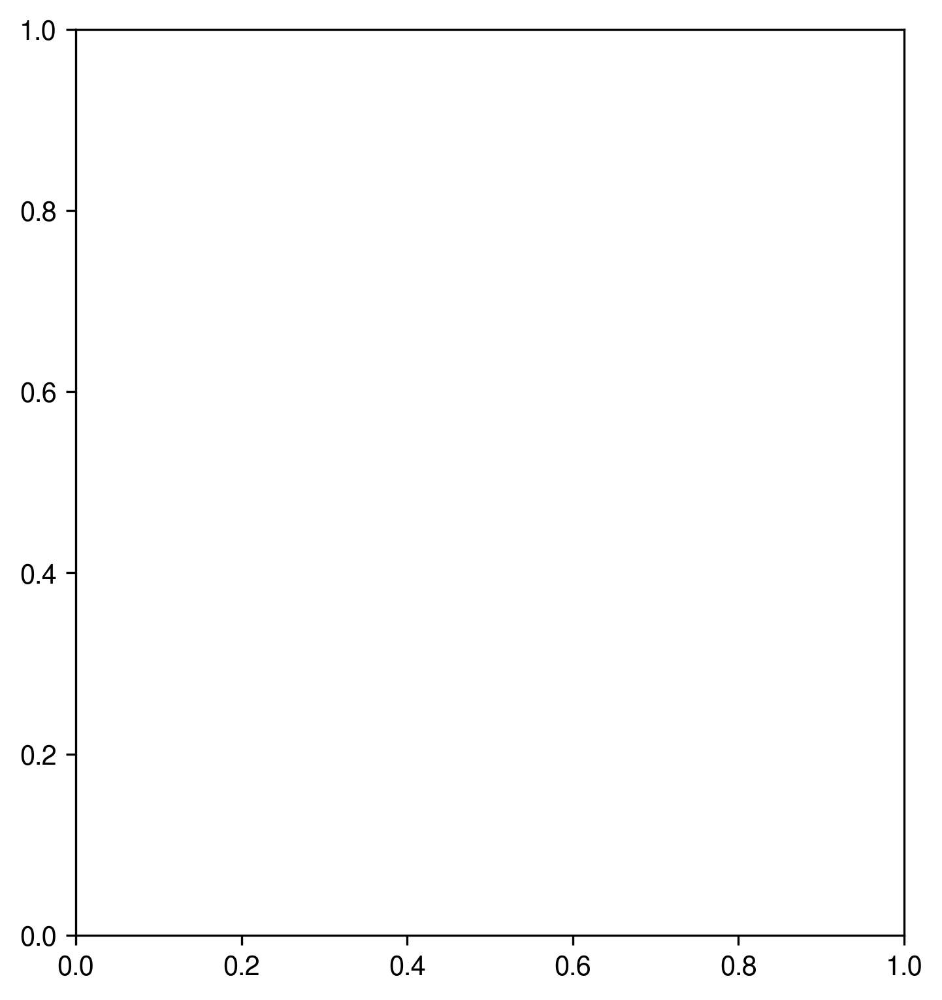

In [ ]:
# Plotting
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.scatter(original_tsne[:, 0], original_tsne[:, 1], c=all_type_list, cmap=cmap, alpha=0.5, label='Original')
plt.title('Original Data')
plt.subplot(1, 2, 2)
plt.scatter(reconstructed_tsne[:, 0], reconstructed_tsne[:, 1], c=all_type_list,cmap=cmap, alpha=0.5, label='Reconstructed')
plt.title('Reconstructed Data')
plt.show()


In [35]:
umap_reducer = UMAP()
# Compute UMAP embeddings
umap_embeddings_z_sem = umap_reducer.fit_transform(all_z_sem)
umap_embeddings_x_T = umap_reducer.fit_transform(all_x_T)

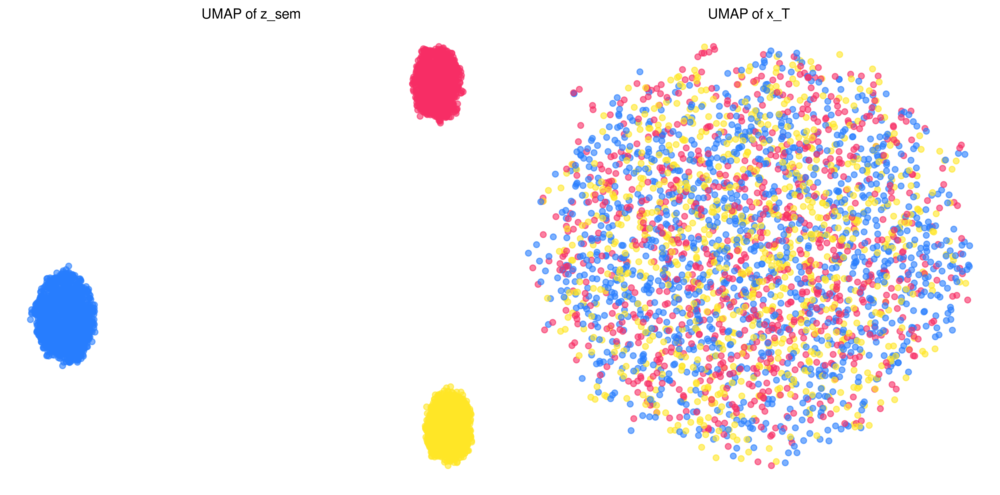

In [36]:
# Plotting the UMAP embeddings for z_sem
plt.figure(figsize=(12, 6),dpi=800)
plt.subplot(1, 2, 1)
plt.scatter(umap_embeddings_z_sem[:, 0], umap_embeddings_z_sem[:, 1], 
            c = all_type, 
            cmap=cmap,
            s=25, alpha=0.6)
plt.title('UMAP of z_sem')
plt.axis('off')
# Plotting the UMAP embeddings for x_T
plt.subplot(1, 2, 2)
plt.scatter(umap_embeddings_x_T[:, 0], umap_embeddings_x_T[:, 1], 
            c = all_type, cmap=cmap,
            s=25, alpha=0.6)
plt.title('UMAP of x_T')
plt.axis('off')
plt.tight_layout()
plt.show()


In [ ]:
# Select a number of time steps for visualization
time_steps_to_visualize = [0, 50, 100, 150, 200,250,300,350,400,450,499]  # Example time steps



# Collect diffused data and cell types at different time steps
diffused_data = {t: [] for t in time_steps_to_visualize}
cell_types = []

# Apply diffusion and collect data for all batches
with torch.no_grad():  # No need to track gradients
    for data, feature in dataloader:
        x_0 = data.to(device)  # Original data
        cell_type = feature[:, 2].cpu().numpy()  # Assuming cell type is in feature[:, 2]
        cell_types.extend(cell_type)  # Collect cell type information

        for t in time_steps_to_visualize:
            noise = torch.randn_like(x_0)
            x_t = squid_model.diffuse(x_0, torch.tensor([t]), noise)
            diffused_data[t].append(x_t.detach().cpu().numpy())

# Initialize UMAP
umap_reducer = UMAP()
# Concatenate the collected data for UMAP embedding computation
for t in time_steps_to_visualize:
    diffused_data[t] = np.concatenate(diffused_data[t], axis=0)

# Compute UMAP embeddings for each time step
umap_embeddings = {}
for t in time_steps_to_visualize:
    data = diffused_data[t].reshape(diffused_data[t].shape[0], -1)  # Reshape if needed
    umap_embeddings[t] = umap_reducer.fit_transform(data)


In [ ]:
# Define your time steps and window size
final_time_step = 250
window_size = 5
time_steps_to_visualize = list(range(0, final_time_step + 1, window_size))
umap_reducer = UMAP(n_components=1)
diffused_data = []
for j, t in enumerate(time_steps_to_visualize):
    diffused_data_t = []
    for i, (data, feature) in enumerate(dataloader):
        x_0 = data.to(device)  # Original data
        cell_type = feature[:, 2].cpu().numpy()
        cell_types.extend(cell_type)  # Collect cell type information
        noise = torch.randn_like(x_0)
        x_t = squid_model.diffuse(x_0, torch.tensor([t], device=device), noise).detach().cpu().numpy()
        diffused_data_t.append(x_t)
    diffused_data_t = np.vstack(diffused_data_t)
    x_t_embed = umap_reducer.fit_transform(diffused_data_t)
    diffused_data.append(x_t_embed)
diffused_data = np.array(diffused_data)
diffused_data = diffused_data[:,:,0]

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter

# Assuming diffused_data is a 2D array with shape [time_steps, num_data_points]
num_time_steps, num_data_points = diffused_data.shape

# Define the number of bins for the histogram and the smoothing factor
num_bins = 500
sigma = 2  # Smoothing factor

# Create an array to store the histogram counts
histogram_counts = np.zeros((num_time_steps, num_bins))

# Define the range for the histograms
data_min, data_max = np.min(diffused_data), np.max(diffused_data)
data_min = -25
bin_edges = np.linspace(data_min, data_max, num_bins + 1)

# Compute the histogram for each time step
for i in range(num_time_steps):
    counts, _ = np.histogram(diffused_data[i, :], bins=bin_edges)
    histogram_counts[i, :] = counts



In [ ]:
# Apply Gaussian smoothing
smoothed_histogram_counts = gaussian_filter(histogram_counts, sigma=sigma)

# Plot the smoothed heatmap
plt.figure(figsize=(2,3),dpi=600)
plt.imshow(smoothed_histogram_counts, aspect='auto', origin='lower',
           extent=[bin_edges[0], bin_edges[-1], 0, num_time_steps],
           cmap='magma')
#plt.plot(diffused_data[:,2],list(range(len(time_steps_to_visualize))))
#plt.colorbar(label='Smoothed Counts')
#plt.title('Smoothed Histogram Heatmap of Diffused Data over Time')
plt.xlabel('Diffused Data Value')
plt.ylabel('Time Step')
plt.axis('off')
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

# Extract the first row of diffused_data
first_time_step_data = diffused_data[0, :]

# Define the number of bins for the histogram
num_bins = 50

# Calculate the histogram
hist, bin_edges = np.histogram(first_time_step_data, bins=num_bins, density=True)
bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

# Fit KDE to the data
kde = gaussian_kde(first_time_step_data)

# Evaluate the KDE on a fine grid
kde_grid = np.linspace(data_min, data_max, 1000)
kde_values = kde(kde_grid)

# Plot the histogram and the KDE
plt.figure(figsize=(5,1))
#plt.bar(bin_centers, hist, width=bin_edges[1] - bin_edges[0], alpha=0.5, color='blue', label='Histogram')
plt.plot(kde_grid, kde_values, color='red', label='KDE')
plt.yticks([])
plt.xticks([])
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

# Extract the first row of diffused_data
first_time_step_data = diffused_data[50, :]

# Define the number of bins for the histogram
num_bins = 50

# Calculate the histogram
hist, bin_edges = np.histogram(first_time_step_data, bins=num_bins, density=True)
bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

# Fit KDE to the data
kde = gaussian_kde(first_time_step_data)

# Evaluate the KDE on a fine grid
kde_grid = np.linspace(data_min, data_max, 1000)
kde_values = kde(kde_grid)

# Plot the histogram and the KDE
plt.figure(figsize=(5,1))
#plt.bar(bin_centers, hist, width=bin_edges[1] - bin_edges[0], alpha=0.5, color='blue', label='Histogram')
plt.plot(kde_grid, kde_values, color='red', label='KDE',linewidth=4)
plt.yticks([])
plt.xticks([])
plt.show()


## low-level stochastic variations

ValueError: 'c' argument has 3000 elements, which is inconsistent with 'x' and 'y' with size 9000.

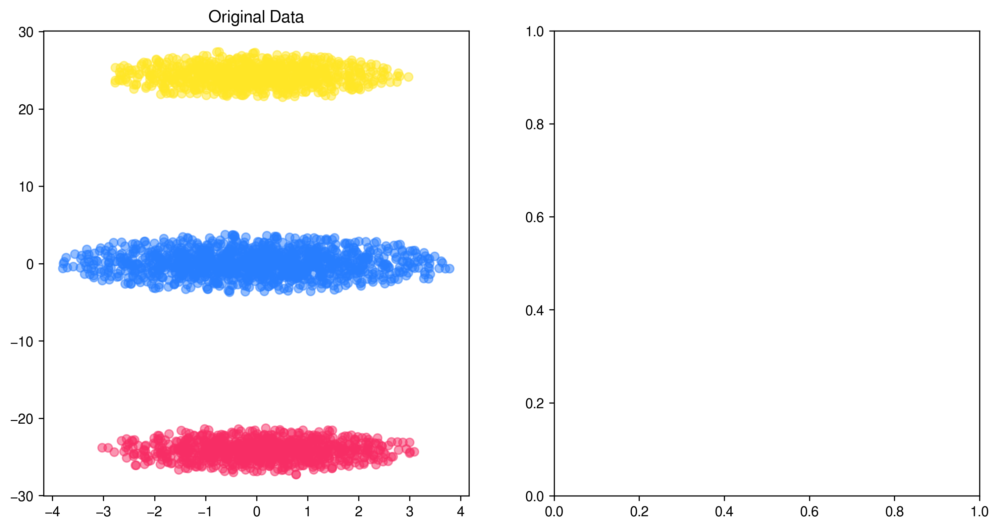

In [135]:
# Plotting
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.scatter(original_tsne[:, 0], original_tsne[:, 1], c=all_type_list, cmap=cmap, alpha=0.5, label='Original')
plt.title('Original Data')
plt.subplot(1, 2, 2)
plt.scatter(reconstructed_tsne[:, 0], reconstructed_tsne[:, 1], c=all_type_list,cmap=cmap, alpha=0.5, label='Reconstructed')
plt.title('Reconstructed Data')
plt.show()


In [50]:
original_data_list = []
noisy_data_list = []
noisy_data_list1 = []
noisy_data_list2 = []
reconstructed_data_list = []
reconstructed_data_list1 = []
reconstructed_data_list2 = []

all_type_list = []
all_recon_xs_list = []
all_recon_xs_list1 = []
all_recon_xs_list2 = []

model.eval()
for data, features in dataloader:
    x_0 = data.to(device)  # Move the batch to the appropriate device
    z_sem = model.semantic_encoder(x_0)  # Compute semantic encoding
    x_T = stochastic_encoder.stochastic_encode(x_0, n_time_steps)  # Compute the encoded data at final timestep
    reverse_process = squidiff.reverse_process(model=model, 
                                               n_steps=n_time_steps,
                                               device=device)
    
    reconstructed_x, all_recon_xs = reverse_process.reconstruct(x_T, z_sem)

    x_T1 = torch.randn_like(x_T)
    reconstructed_x1, all_recon_xs1 = reverse_process.reconstruct(x_T1, z_sem)
    
    x_T2 = torch.randn_like(x_T)
    reconstructed_x2, all_recon_xs2 = reverse_process.reconstruct(x_T2, z_sem)
    
    original_data_list.append(x_0.cpu().detach().numpy())
    noisy_data_list.append(x_T.cpu().detach().numpy())
    noisy_data_list1.append(x_T1.cpu().detach().numpy())
    noisy_data_list2.append(x_T2.cpu().detach().numpy())
    reconstructed_data_list.append(reconstructed_x.cpu().detach().numpy())
    reconstructed_data_list1.append(reconstructed_x1.cpu().detach().numpy())
    reconstructed_data_list2.append(reconstructed_x2.cpu().detach().numpy())
    all_type_list.append(features[:,2:3].detach().cpu().numpy())
    
    all_recon_xs_list.append(all_recon_xs)
    all_recon_xs_list1.append(all_recon_xs1)
    all_recon_xs_list2.append(all_recon_xs2)

noisy_data_array = np.concatenate(noisy_data_list, axis=0)
noisy_data_array1 = np.concatenate(noisy_data_list1, axis=0)
noisy_data_array2 = np.concatenate(noisy_data_list2, axis=0)

reconstructed_data_array = np.concatenate(reconstructed_data_list, axis=0)
reconstructed_data_array1 = np.concatenate(reconstructed_data_list1, axis=0)
reconstructed_data_array2 = np.concatenate(reconstructed_data_list2, axis=0)

original_array = np.concatenate(original_data_list, axis=0)
all_type_list = np.concatenate(all_type_list,axis=0)
merged_dict = {key: torch.cat([d[key] for d in all_recon_xs_list]) for key in all_recon_xs_list[0]}
merged_dict1 = {key: torch.cat([d[key] for d in all_recon_xs_list1]) for key in all_recon_xs_list1[0]}
merged_dict2 = {key: torch.cat([d[key] for d in all_recon_xs_list2]) for key in all_recon_xs_list2[0]}

NameError: name 'TSNE' is not defined

In [51]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
original_tsne = tsne.fit_transform(original_array)


In [52]:
recon_all = np.concatenate([reconstructed_data_array,
                reconstructed_data_array1, reconstructed_data_array2],axis=0)

In [53]:

recon_all_color = np.concatenate([np.ones([3000,1]),
                np.ones([3000,1])*2, np.ones([3000,1])*3],axis=0)

In [54]:
reconstructed_tsne = tsne.fit_transform(recon_all)


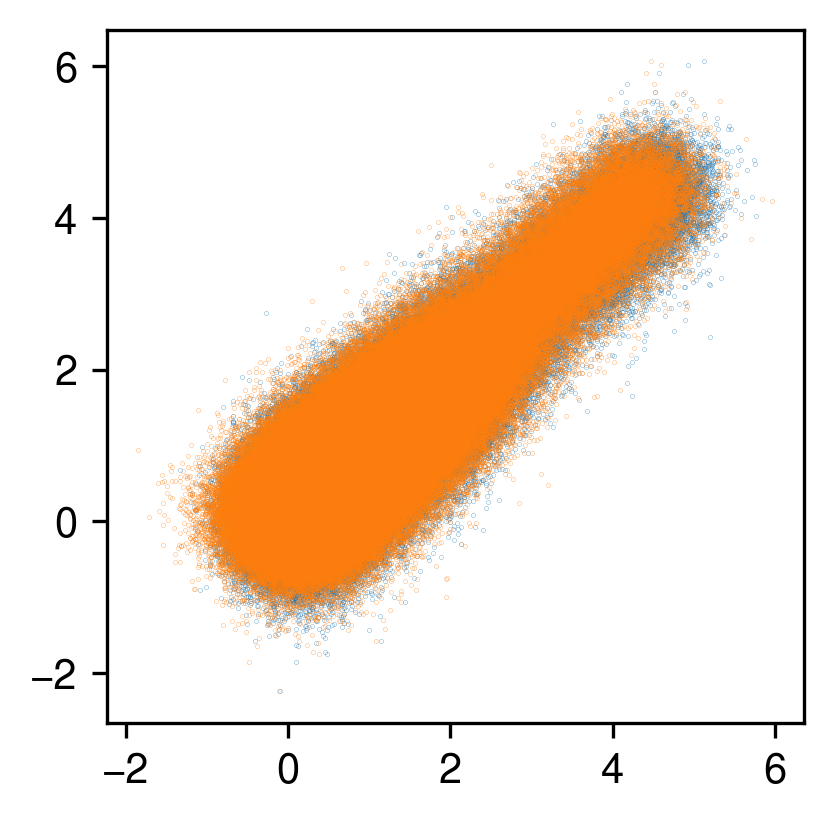

In [67]:
plt.scatter(reconstructed_data_array.flatten(),
            reconstructed_data_array2.flatten(),s=0.005)
plt.scatter(reconstructed_data_array1.flatten(),
            reconstructed_data_array2.flatten(),s=0.005)

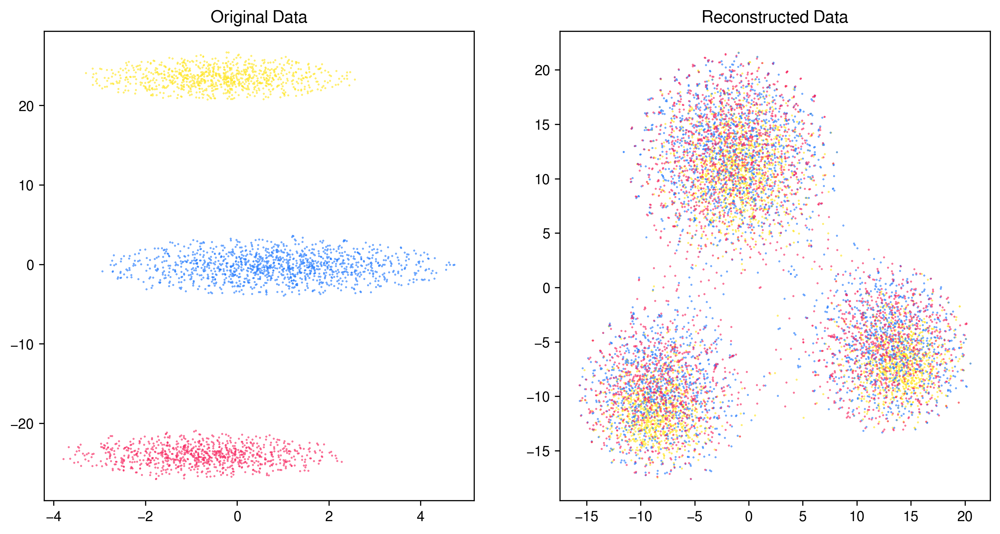

In [63]:
# Plotting
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.scatter(original_tsne[:, 0], original_tsne[:, 1], c=all_type_list, cmap=cmap, alpha=1, s=0.1,label='Original')
plt.title('Original Data')
plt.subplot(1, 2, 2)
plt.scatter(reconstructed_tsne[:, 0], reconstructed_tsne[:, 1], c=recon_all_color,cmap=cmap, alpha=1,s=0.1, label='Reconstructed')
plt.title('Reconstructed Data')
plt.show()


In [92]:
# Define your hexadecimal color codes
import matplotlib.colors as mcolors
hex_colors = ['#ffe626', '#267dff', '#f72d65']
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)

hex_colors = ['#cbe075', '#97def0', '#eba2de']
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]
cmap1 = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)

hex_colors = ['#fa842f', '#7926ff', '#f72de6']
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]
cmap2 = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)


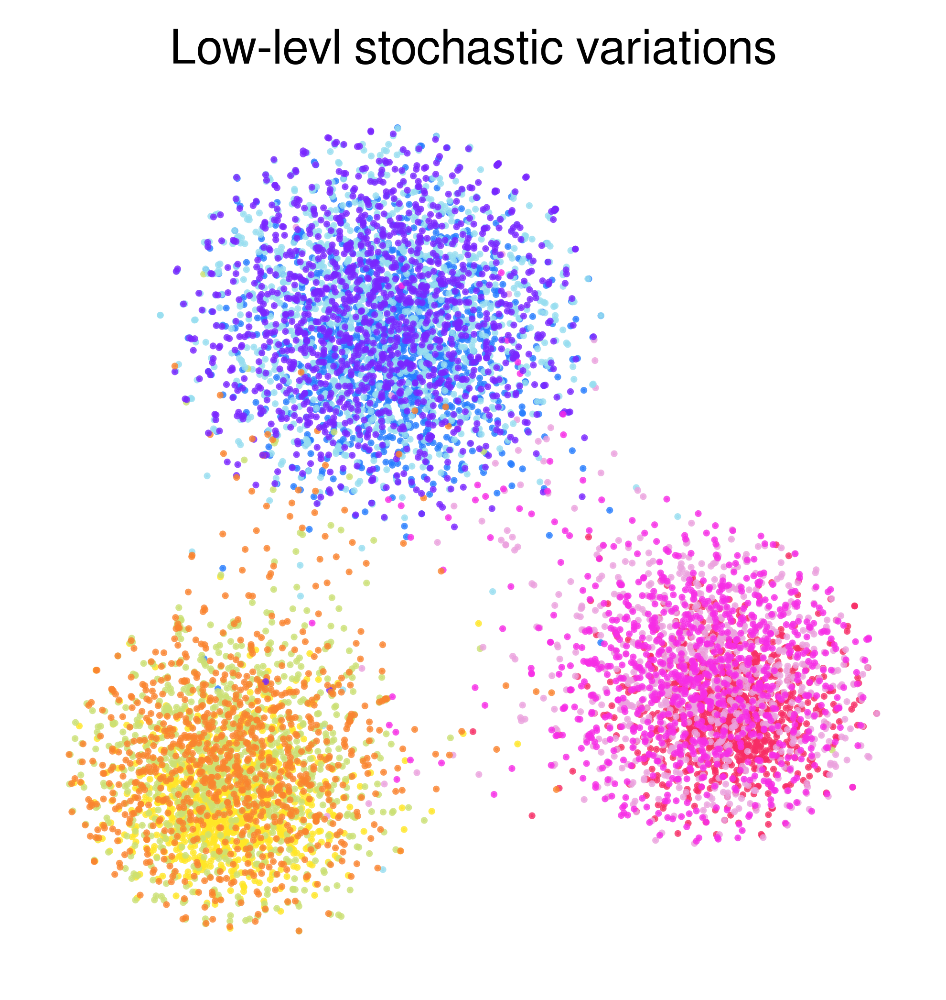

In [101]:
fig, axs = plt.subplots(1,1,figsize=(4,4),dpi=600)
axs.scatter(reconstructed_tsne[:3000, 0], reconstructed_tsne[:3000, 1], c=all_type_list,cmap=cmap, alpha=0.8,s=0.5, label='Reconstructed')
axs.scatter(reconstructed_tsne[3000:6000, 0], reconstructed_tsne[3000:6000, 1], c=all_type_list,cmap=cmap1, alpha=0.8,s=0.5, label='Reconstructed')
axs.scatter(reconstructed_tsne[6000:9000, 0], reconstructed_tsne[6000:9000, 1], c=all_type_list,cmap=cmap2, alpha=0.8,s=0.5, label='Reconstructed')

axs.set_title('Low-levl stochastic variations')
plt.axis('off')
plt.show()

## high-level stochastic variations

In [122]:
original_data_list = []
noisy_data_list = []
noisy_data_list1 = []
noisy_data_list2 = []
reconstructed_data_list = []
reconstructed_data_list1 = []
reconstructed_data_list2 = []

all_type_list = []
all_recon_xs_list = []
all_recon_xs_list1 = []
all_recon_xs_list2 = []

model.eval()
for data, features in dataloader:
    x_0 = data.to(device)  # Move the batch to the appropriate device
    z_sem = model.semantic_encoder(x_0)  # Compute semantic encoding
    x_T = stochastic_encoder.stochastic_encode(x_0, n_time_steps)  # Compute the encoded data at final timestep
    reverse_process = squidiff.reverse_process(model=model, 
                                               n_steps=n_time_steps,
                                               device=device)
    
    reconstructed_x, all_recon_xs = reverse_process.reconstruct(x_T, z_sem)

    #x_T1 = torch.randn_like(x_T)
    z_sem1 = z_sem.clone()
    z_sem1[:,2]=z_sem1[:,2]-0.5
    reconstructed_x1, all_recon_xs1 = reverse_process.reconstruct(x_T, z_sem1)
    
    #x_T2 = torch.randn_like(x_T)
    z_sem2 = z_sem.clone()
    z_sem2[:,2]=z_sem2[:,2]+0.5
    reconstructed_x2, all_recon_xs2 = reverse_process.reconstruct(x_T, z_sem2)
    
    original_data_list.append(x_0.cpu().detach().numpy())
    noisy_data_list.append(x_T.cpu().detach().numpy())
    noisy_data_list1.append(x_T.cpu().detach().numpy())
    noisy_data_list2.append(x_T.cpu().detach().numpy())
    reconstructed_data_list.append(reconstructed_x.cpu().detach().numpy())
    reconstructed_data_list1.append(reconstructed_x1.cpu().detach().numpy())
    reconstructed_data_list2.append(reconstructed_x2.cpu().detach().numpy())
    all_type_list.append(features[:,2:3].detach().cpu().numpy())
    
    all_recon_xs_list.append(all_recon_xs)
    all_recon_xs_list1.append(all_recon_xs1)
    all_recon_xs_list2.append(all_recon_xs2)

noisy_data_array = np.concatenate(noisy_data_list, axis=0)
noisy_data_array1 = np.concatenate(noisy_data_list1, axis=0)
noisy_data_array2 = np.concatenate(noisy_data_list2, axis=0)

reconstructed_data_array = np.concatenate(reconstructed_data_list, axis=0)
reconstructed_data_array1 = np.concatenate(reconstructed_data_list1, axis=0)
reconstructed_data_array2 = np.concatenate(reconstructed_data_list2, axis=0)

original_array = np.concatenate(original_data_list, axis=0)
all_type_list = np.concatenate(all_type_list,axis=0)
merged_dict = {key: torch.cat([d[key] for d in all_recon_xs_list]) for key in all_recon_xs_list[0]}
merged_dict1 = {key: torch.cat([d[key] for d in all_recon_xs_list1]) for key in all_recon_xs_list1[0]}
merged_dict2 = {key: torch.cat([d[key] for d in all_recon_xs_list2]) for key in all_recon_xs_list2[0]}

In [123]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
original_tsne = tsne.fit_transform(original_array)


In [124]:
recon_all = np.concatenate([reconstructed_data_array,
                reconstructed_data_array1, reconstructed_data_array2],axis=0)

In [125]:

recon_all_color = np.concatenate([np.ones([3000,1]),
                np.ones([3000,1])*2, np.ones([3000,1])*3],axis=0)

In [126]:
reconstructed_tsne = tsne.fit_transform(recon_all)


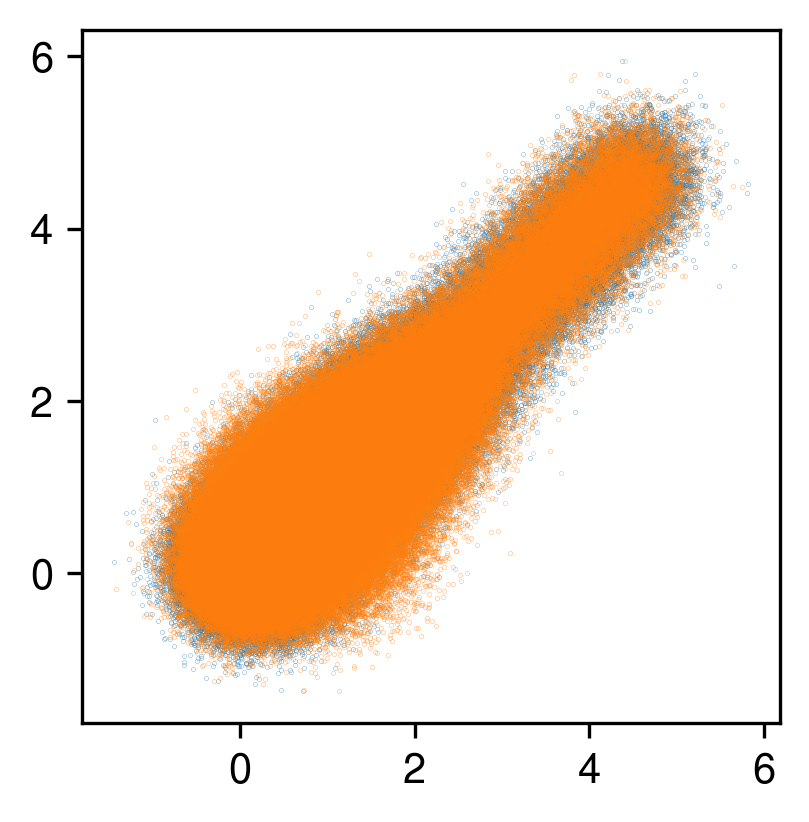

In [127]:
plt.scatter(reconstructed_data_array.flatten(),
            reconstructed_data_array2.flatten(),s=0.005)
plt.scatter(reconstructed_data_array1.flatten(),
            reconstructed_data_array2.flatten(),s=0.005)

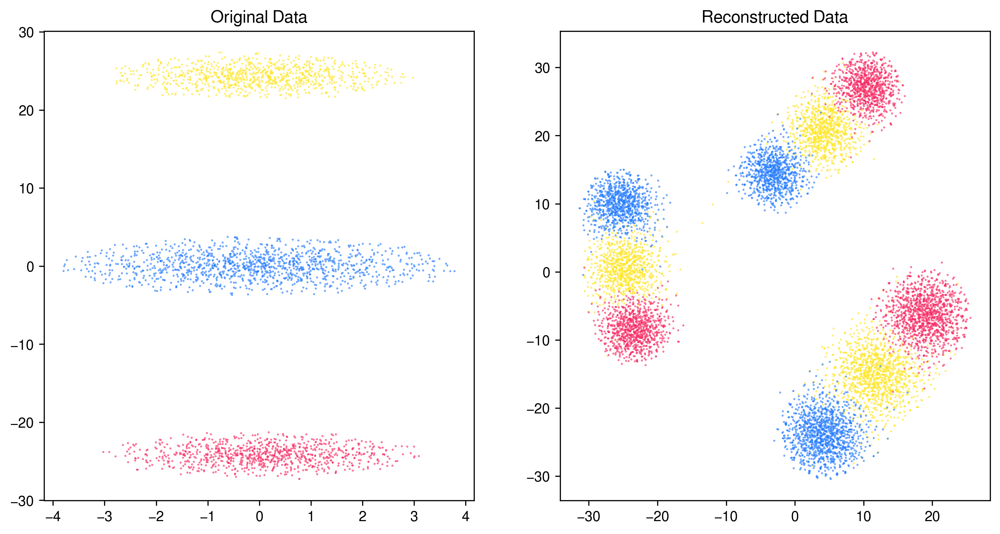

In [128]:
# Plotting
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.scatter(original_tsne[:, 0], original_tsne[:, 1], c=all_type_list, cmap=cmap, alpha=1, s=0.1,label='Original')
plt.title('Original Data')
plt.subplot(1, 2, 2)
plt.scatter(reconstructed_tsne[:, 0], reconstructed_tsne[:, 1], c=recon_all_color,cmap=cmap, alpha=1,s=0.1, label='Reconstructed')
plt.title('Reconstructed Data')
plt.show()


In [129]:
# Define your hexadecimal color codes
import matplotlib.colors as mcolors
hex_colors = ['#ffe626', '#267dff', '#f72d65']
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)

hex_colors = ['#cbe075', '#97def0', '#eba2de']
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]
cmap1 = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)

hex_colors = ['#fa842f', '#7926ff', '#f72de6']
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]
cmap2 = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)



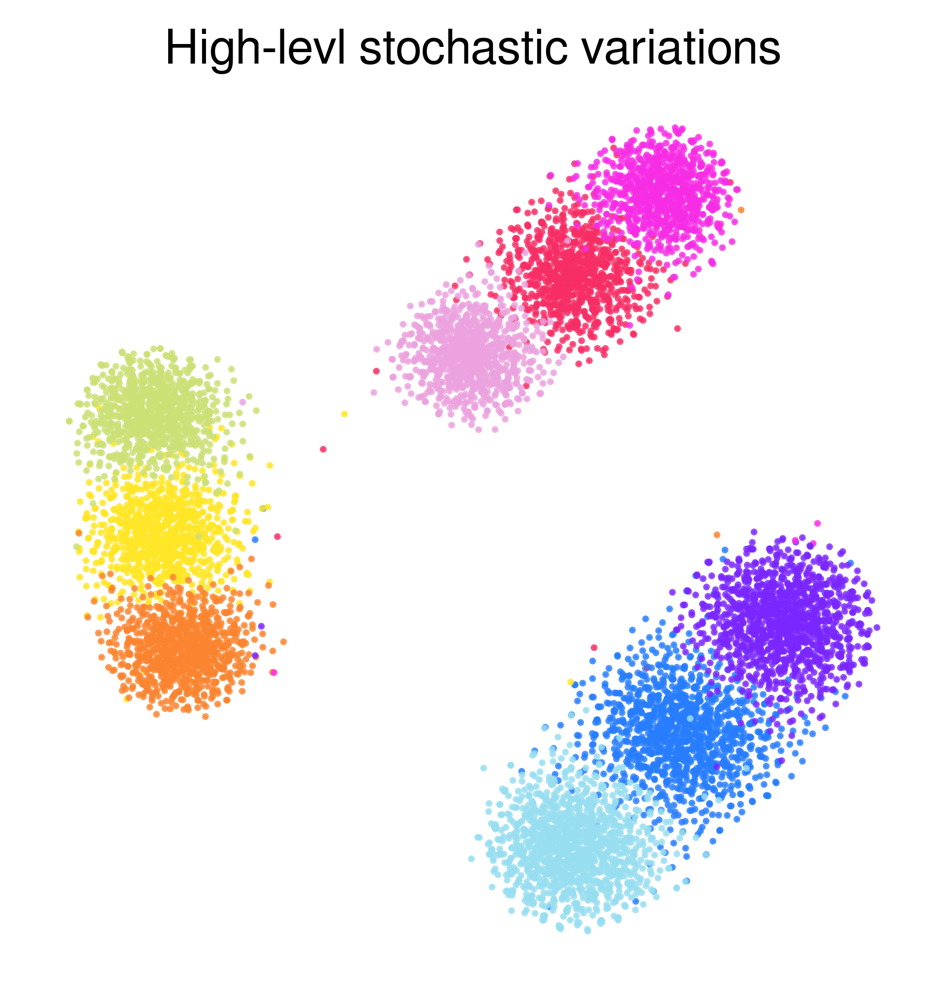

In [131]:
fig, axs = plt.subplots(1,1,figsize=(4,4),dpi=600)
axs.scatter(reconstructed_tsne[:3000, 0], reconstructed_tsne[:3000, 1], c=all_type_list,cmap=cmap, alpha=0.8,s=0.5, label='Reconstructed')
axs.scatter(reconstructed_tsne[3000:6000, 0], reconstructed_tsne[3000:6000, 1], c=all_type_list,cmap=cmap1, alpha=0.8,s=0.5, label='Reconstructed')
axs.scatter(reconstructed_tsne[6000:9000, 0], reconstructed_tsne[6000:9000, 1], c=all_type_list,cmap=cmap2, alpha=0.8,s=0.5, label='Reconstructed')

axs.set_title('High-levl stochastic variations')
plt.axis('off')
plt.show()

## perturbation test

In [67]:
original_data_list = []
noisy_data_list = []
noisy_data_list1 = []
noisy_data_list2 = []
reconstructed_data_list = []
reconstructed_data_list1 = []
reconstructed_data_list2 = []

all_type_list = []
all_recon_xs_list = []
all_recon_xs_list1 = []
all_recon_xs_list2 = []

model.eval()
for data, features in dataloader:
    x_0 = data.to(device)  # Move the batch to the appropriate device
    z_sem = model.semantic_encoder(x_0)  # Compute semantic encoding
    x_T = stochastic_encoder.stochastic_encode(x_0, n_time_steps)  # Compute the encoded data at final timestep
    reverse_process = squidiff.reverse_process(model=model, 
                                               n_steps=n_time_steps,
                                               device=device)
    
    reconstructed_x, all_recon_xs = reverse_process.reconstruct(x_T, z_sem)

    x_T1 = x_T.clone()
    x_T1[:,2]=x_T1[:,2]+100
    reconstructed_x1, all_recon_xs1 = reverse_process.reconstruct(x_T1, z_sem)
    
    x_T2 = x_T.clone()
    x_T2[:,20]=x_T2[:,20]+100
    reconstructed_x2, all_recon_xs2 = reverse_process.reconstruct(x_T2, z_sem)
    
    original_data_list.append(x_0.cpu().detach().numpy())
    noisy_data_list.append(x_T.cpu().detach().numpy())
    noisy_data_list1.append(x_T1.cpu().detach().numpy())
    noisy_data_list2.append(x_T2.cpu().detach().numpy())
    reconstructed_data_list.append(reconstructed_x.cpu().detach().numpy())
    reconstructed_data_list1.append(reconstructed_x1.cpu().detach().numpy())
    reconstructed_data_list2.append(reconstructed_x2.cpu().detach().numpy())
    all_type_list.append(features[:,2:3].detach().cpu().numpy())
    
    all_recon_xs_list.append(all_recon_xs)
    all_recon_xs_list1.append(all_recon_xs1)
    all_recon_xs_list2.append(all_recon_xs2)

noisy_data_array = np.concatenate(noisy_data_list, axis=0)
noisy_data_array1 = np.concatenate(noisy_data_list1, axis=0)
noisy_data_array2 = np.concatenate(noisy_data_list2, axis=0)

reconstructed_data_array = np.concatenate(reconstructed_data_list, axis=0)
reconstructed_data_array1 = np.concatenate(reconstructed_data_list1, axis=0)
reconstructed_data_array2 = np.concatenate(reconstructed_data_list2, axis=0)

original_array = np.concatenate(original_data_list, axis=0)
all_type_list = np.concatenate(all_type_list,axis=0)
merged_dict = {key: torch.cat([d[key] for d in all_recon_xs_list]) for key in all_recon_xs_list[0]}
merged_dict1 = {key: torch.cat([d[key] for d in all_recon_xs_list1]) for key in all_recon_xs_list1[0]}
merged_dict2 = {key: torch.cat([d[key] for d in all_recon_xs_list2]) for key in all_recon_xs_list2[0]}

# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
original_tsne = tsne.fit_transform(original_array)


In [68]:
recon_all = np.concatenate([reconstructed_data_array,
                reconstructed_data_array1, reconstructed_data_array2],axis=0)

In [69]:

recon_all_color = np.concatenate([np.ones([3000,1]),
                np.ones([3000,1])*2, np.ones([3000,1])*3],axis=0)

In [70]:
reconstructed_tsne = tsne.fit_transform(recon_all)


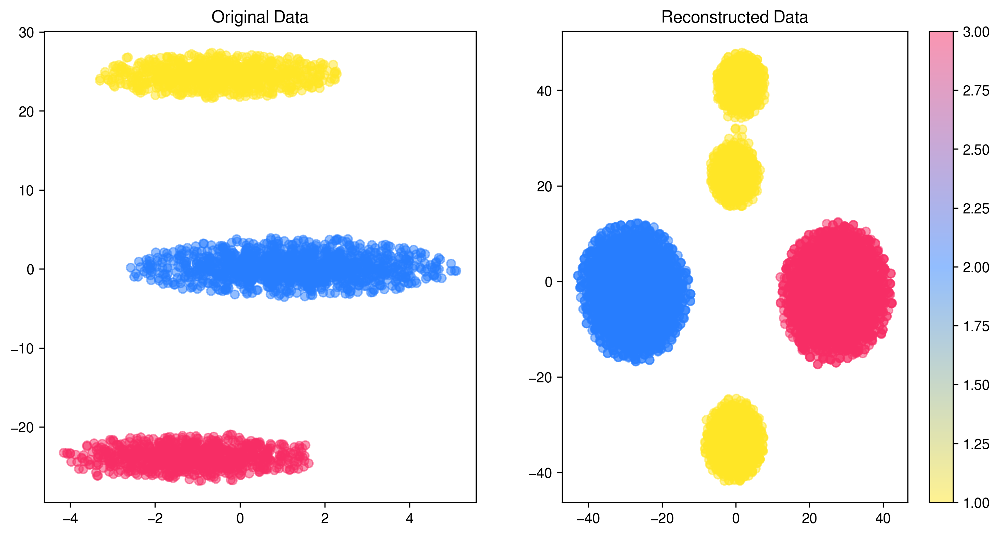

In [73]:
# Plotting
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.scatter(original_tsne[:, 0], original_tsne[:, 1], c=all_type_list,cmap=cmap, alpha=0.5, label='Original')
plt.title('Original Data')
plt.subplot(1, 2, 2)
plt.scatter(reconstructed_tsne[:, 0], reconstructed_tsne[:, 1], c=recon_all_color,cmap=cmap, alpha=0.5, label='Reconstructed')
plt.colorbar()
plt.title('Reconstructed Data')
plt.show()


## semantically meaningful latent interpolation

In [36]:

from collections import defaultdict
# Assuming model, stochastic_encoder, reverse_process are defined and initialized
z_sem_means = defaultdict(list)
x_T_means = defaultdict(list)
model.eval()
# First pass to calculate mean z_sem for each state
for data, features in dataloader:
    x_0 = data.to(device)
    z_sem = model.semantic_encoder(x_0)
    x_T = stochastic_encoder.stochastic_encode(x_0, n_time_steps)
    cell_types = features[:, 2].cpu().numpy()
    for z, x_T_, cell_type in zip(z_sem, x_T, cell_types):
        z_sem_means[cell_type].append(z.cpu().detach().numpy())
        x_T_means[cell_type].append(x_T_.cpu().detach().numpy())
        
# Calculate mean z_sem for each cell type
for cell_type in z_sem_means:
    z_sem_means[cell_type] = np.mean(z_sem_means[cell_type], axis=0)
    
for cell_type in x_T_means:
    x_T_means[cell_type] = np.mean(x_T_means[cell_type], axis=0)

reverse_process = squidiff.reverse_process(model=model, 
                                           n_steps=n_time_steps,
                                           device=device)

In [50]:
adata.obs

,Cell,Batch,Group,ExpLibSize,sizeFactor,n_genes
Cell1,0,0,0,65719.453475,1.079262,1614
Cell2,1,0,0,64703.719554,1.039752,1605
Cell3,2,0,1,56694.985762,0.920619,1590
Cell4,3,0,1,88586.313903,1.443466,1671
Cell5,4,0,0,52167.163689,0.848159,1576
...,...,...,...,...,...,...
Cell2996,2995,0,0,59599.657648,0.987446,1601
Cell2997,2996,0,0,69106.942703,1.112146,1631
Cell2998,2997,0,2,49291.141002,0.800053,1553
Cell2999,2998,0,1,54991.791173,0.897372,1585


In [52]:
def lerp(x0, start, end, weight):
    """Linear interpolation between start and end"""
    return x0 + weight * (end - start)

def slerp(x0, start, end, weight):
    """Spherical linear interpolation between start and end for 1D tensors"""
    # Normalize start and end
    start_norm = start / torch.norm(start)
    end_norm = end / torch.norm(end)

    # Compute dot product, omega, and sin(omega)
    dot_product = torch.dot(start_norm, end_norm)
    omega = torch.acos(torch.clamp(dot_product, -1.0, 1.0))
    sin_omega = torch.sin(omega)

    # Compute interpolation
    s1 = torch.sin((1.0 - weight) * omega) / sin_omega
    s2 = torch.sin(weight * omega) / sin_omega

    return x0 + (s1 * start + s2 * end)

all_reconstructed_x = []
all_weights = []
all_cell_types = []


# Initialize your custom dataset with the AnnData object

batch_size = 8
# Create a DataLoader with the custom dataset
start_dataloader = DataLoader(datasets.AnnDataDataset(adata[adata.obs['Group']==2].copy()), batch_size=8, shuffle=True)
end_dataloader = DataLoader(datasets.AnnDataDataset(adata[adata.obs['Group']==1].copy()), batch_size=8, shuffle=True)


for data, features in start_dataloader:
    x_0 = data.to(device)
    z_sem = model.semantic_encoder(x_0)
    x_T = stochastic_encoder.stochastic_encode(x_0, n_time_steps)
    
    reconstructed_x, _ = reverse_process.reconstruct(x_T, z_sem)
    all_reconstructed_x.append(reconstructed_x.cpu().detach().numpy())
    all_weights.append(np.full((reconstructed_x.shape[0],), 0))
    all_cell_types.append(cell_types)

    z_sem_start = torch.tensor(z_sem_means[2], device=device)  # State 0 mean
    z_sem_end = torch.tensor(z_sem_means[1], device=device)    # State 3 mean

    x_T_start = torch.tensor(x_T_means[2], device=device)  # State 0 mean
    x_T_end = torch.tensor(x_T_means[1], device=device)    # State 3 mean


    cell_types = features[:, 2].cpu().numpy()


    for weight in [0.25, 0.5, 0.75]:
        z_sem_interp = lerp(z_sem, z_sem_start, z_sem_end, weight)
        x_T_interp = slerp(x_T, x_T_start, x_T_end, weight) 

        reconstructed_x, _ = reverse_process.reconstruct(x_T_interp, z_sem_interp)
        all_reconstructed_x.append(reconstructed_x.cpu().detach().numpy())
        all_weights.append(np.full((reconstructed_x.shape[0],), weight))
        all_cell_types.append(cell_types)
        
for data, features in end_dataloader:
    x_0 = data.to(device)
    z_sem = model.semantic_encoder(x_0)
    x_T = stochastic_encoder.stochastic_encode(x_0, n_time_steps)
    reconstructed_x, _ = reverse_process.reconstruct(x_T, z_sem)
    
    all_reconstructed_x.append(reconstructed_x.cpu().detach().numpy())
    all_weights.append(np.full((reconstructed_x.shape[0],), 1))
    all_cell_types.append(cell_types)
    
# Convert lists to numpy arrays for further processing or saving
all_reconstructed_x = np.concatenate(all_reconstructed_x, axis=0)
all_weights = np.concatenate(all_weights, axis=0)
all_cell_types = np.concatenate(all_cell_types, axis=0)


In [53]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
all_tsne = tsne.fit_transform(all_reconstructed_x)


In [54]:
all_tsne.shape

(4756, 2)

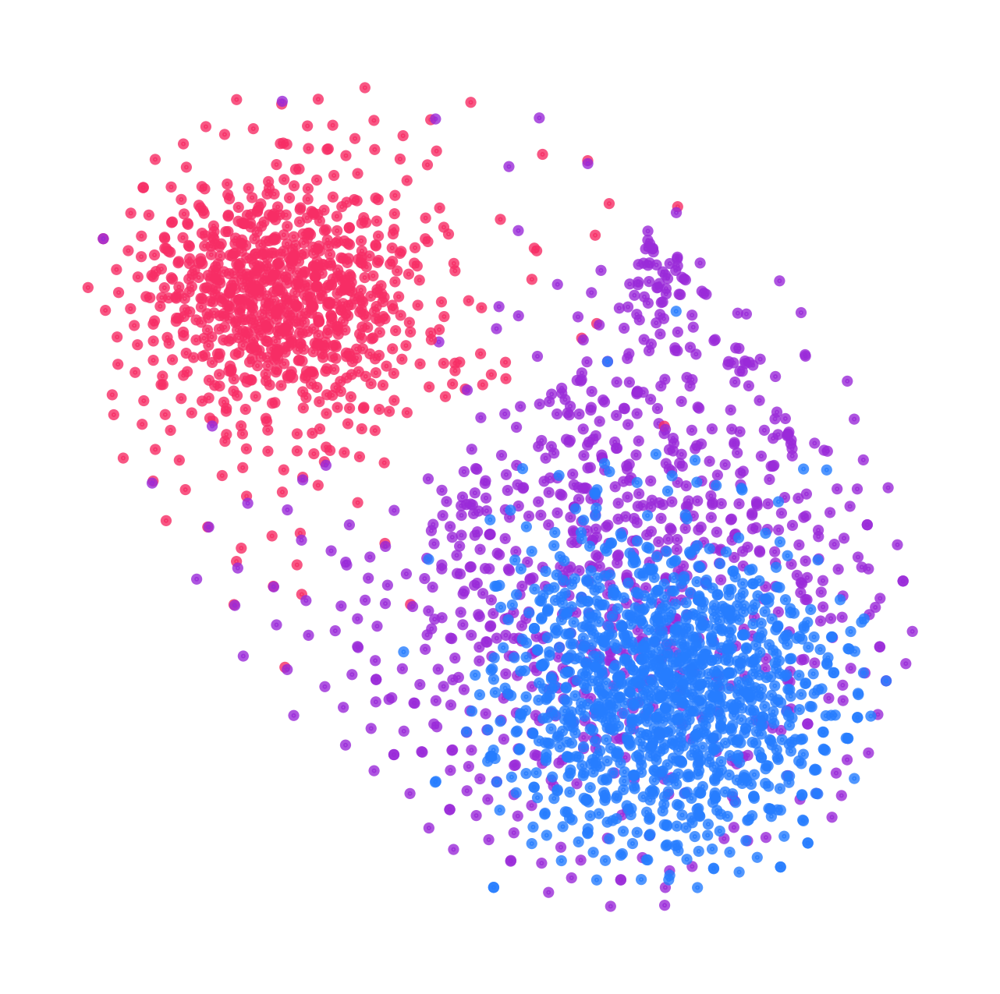

In [91]:
import matplotlib.colors as mcolors
hex_colors = ['#f72d65','#7b29ff','#267dff','#267dff']
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)
# Create a discrete colormap
#cmap = mcolors.ListedColormap(rgb_colors)


fig, axs = plt.subplots(1,1,figsize=(2.5,2.5),dpi=600)
g=axs.scatter(all_tsne[(all_weights==0)|(all_weights==0.75)|(all_weights==1), 0], 
              all_tsne[(all_weights==0)|(all_weights==0.75)|(all_weights==1), 1], 
              c=all_weights[(all_weights==0)|(all_weights==0.25)|(all_weights==1)],
              cmap=cmap, alpha=0.8,s=0.5, label='Reconstructed')
plt.axis('off')
plt.show()

In [ ]:
import matplotlib.colors as mcolors
hex_colors = ['#f72d65','#5e34eb','#267dff']
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)


fig, axs = plt.subplots(1,1,figsize=(4,4),dpi=600)
g=axs.scatter(all_tsne[(all_weights==0)|(all_weights==0.25)|(all_weights==1), 0], 
              all_tsne[(all_weights==0)|(all_weights==0.25)|(all_weights==1), 1], 
              c=all_weights[(all_weights==0)|(all_weights==0.25)|(all_weights==1)],
              cmap=cmap, alpha=0.8,s=0.5, label='Reconstructed')
plt.colorbar(g)
axs.set_title('High-levl stochastic variations')
plt.axis('off')
plt.show()

In [ ]:
import matplotlib.colors as mcolors
hex_colors = ['#f72d65','#5e34eb','#267dff']
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)


fig, axs = plt.subplots(1,1,figsize=(4,4),dpi=600)
g=axs.scatter(all_tsne[(all_weights==0)|(all_weights==0.25)|(all_weights==1), 0], 
              all_tsne[(all_weights==0)|(all_weights==0.25)|(all_weights==1), 1], 
              c=all_weights[(all_weights==0)|(all_weights==0.25)|(all_weights==1)],
              cmap=cmap, alpha=0.8,s=0.5, label='Reconstructed')
plt.colorbar(g)
axs.set_title('High-levl stochastic variations')
plt.axis('off')
plt.show()

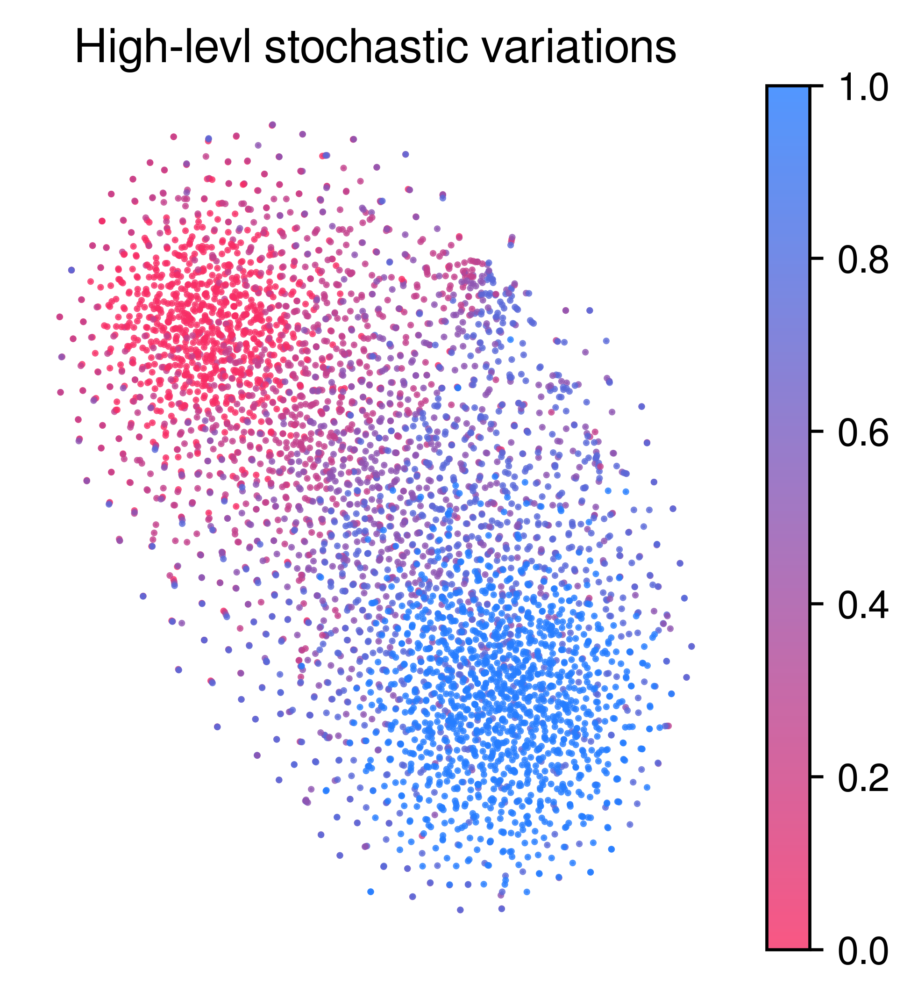

In [65]:
import matplotlib.colors as mcolors
hex_colors = ['#f72d65','#267dff']
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)


fig, axs = plt.subplots(1,1,figsize=(4,4),dpi=600)
g=axs.scatter(all_tsne[:, 0], all_tsne[:, 1], c=all_weights,cmap=cmap, alpha=0.8,s=0.5, label='Reconstructed')
plt.colorbar(g)
axs.set_title('High-levl stochastic variations')
plt.axis('off')
plt.show()